In [231]:
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt

In [232]:
dir_path = 'TB_Chest_Radiography_Database'

Subset: Normal
Index: 1
File name: Normal-1.png
Mode: RGB
Size: (512, 512)


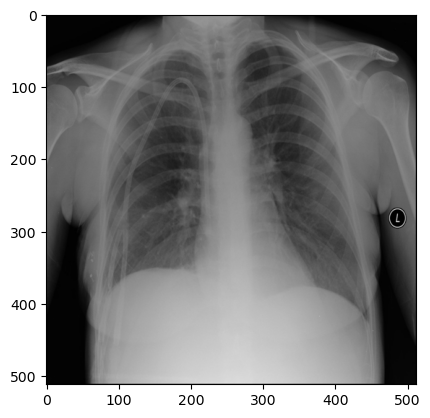

Index: 2
File name: Normal-2.png
Mode: RGB
Size: (512, 512)


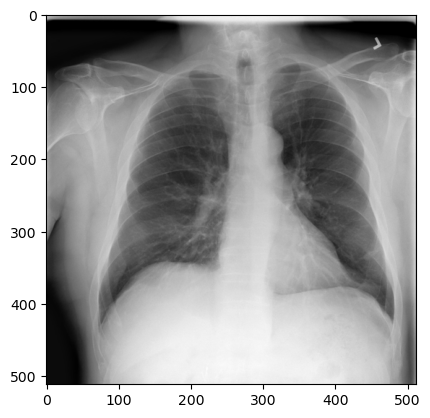

Index: 3
File name: Normal-3.png
Mode: RGB
Size: (512, 512)


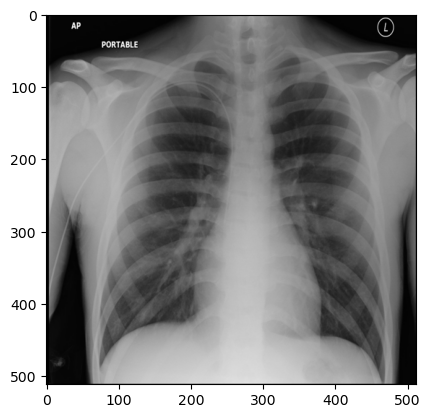

Index: 4
File name: Normal-4.png
Mode: RGB
Size: (512, 512)


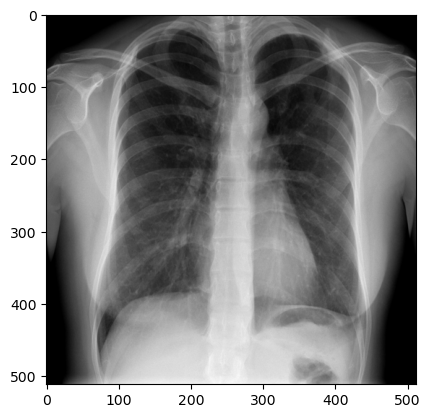

Subset: Tuberculosis
Index: 1
File name: Tuberculosis-1.png
Mode: RGB
Size: (512, 512)


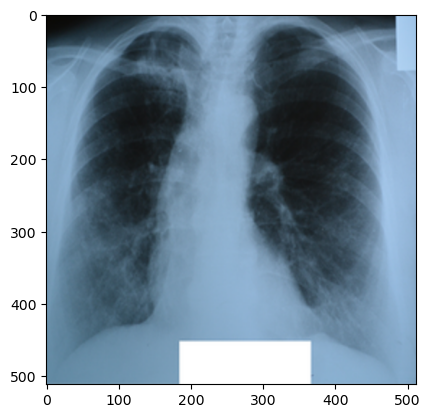

Index: 2
File name: Tuberculosis-2.png
Mode: RGB
Size: (512, 512)


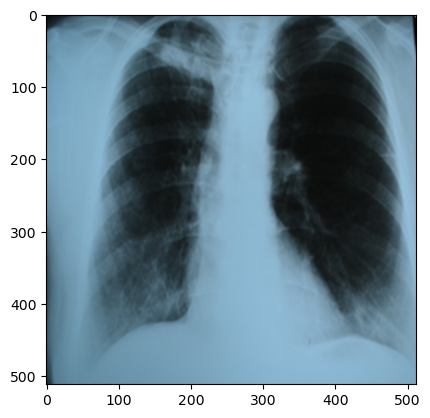

Index: 3
File name: Tuberculosis-3.png
Mode: RGB
Size: (512, 512)


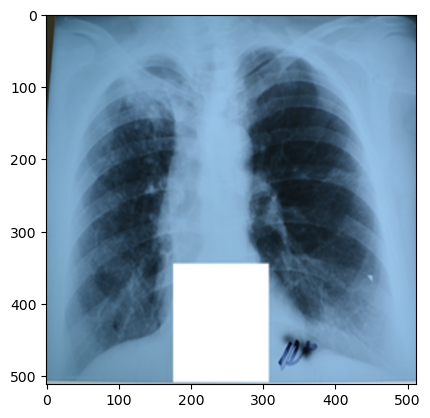

Index: 4
File name: Tuberculosis-4.png
Mode: L
Size: (512, 512)


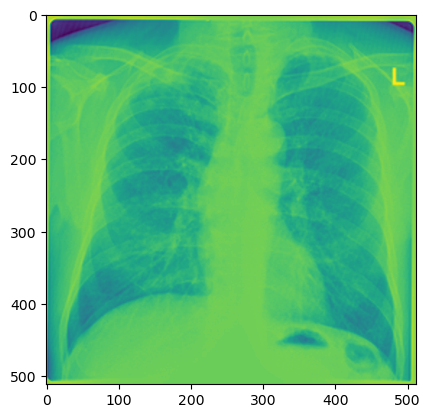

In [233]:
for subset in ['Normal','Tuberculosis']:
    
    
    prefix_bold = "\033[1m"
    suffix_bold = "\033[0m"
    print(f"{prefix_bold}Subset: {subset}{suffix_bold}")
    
    # range(start, stop, step)
    for i in range(1,5):
        
        image = Image.open(
            f"{dir_path}/{subset}/{subset}-{i}.png")
        print(f"Index: {i}")
        print(f"File name: {subset}-{i}.png")
        print(f"Mode: {image.mode}")
        print(f"Size: {image.size}")
        plt.imshow(image)
        plt.show()
        

In [234]:
import os
from tqdm import tqdm
import pandas as pd
import numpy as np

### Data Check-up
<u>explore</u> the dimensions and image information of raw data 

In [235]:
def Image_info_checker(subset, dir_path):
    image_dir = os.path.join(dir_path, subset)
    image_files = os.listdir(image_dir)
    image_count = len(image_files)
    
    data = []
    
    for i in tqdm(range(1, image_count + 1), desc='Checking...'):
        image_path = os.path.join(image_dir, f'{subset}-{i}.png')
        image = Image.open(image_path)
        
        img_name = f'{subset}-{i}.png'
        img_mode = image.mode
        img_size = image.size
        img_format = image.format
        img_channels = image.getbands()
        img_histogram = tuple(image.histogram()) # Convert to tuple for to use with "Plot", Because "image.histogram()"" will return as a list
        img_mean = np.mean(image)
        img_std = np.std(image)
        
        data.append({'image_name': img_name, 'mode': img_mode, 'size': img_size, 'format': img_format,
                     'channels': img_channels, 'histogram': img_histogram, 'mean': img_mean, 'std': img_std, 'image_path': image_path})
        
    # Convert data to DataFrame
    df = pd.DataFrame(data)
    def summary(df, subset, dir_path):
        print(f"{prefix_bold}Directory path{suffix_bold}: {dir_path}")
        print(f"{prefix_bold}Subset{suffix_bold}: {subset}")
        print(f"{prefix_bold}Size{suffix_bold}:\n")
        print(df['size'].value_counts().to_string(header=False))
        print(f"\n{prefix_bold}Format{suffix_bold}:\n")
        print(df['format'].value_counts().to_string(header=False))
        print(f"\n{prefix_bold}Mode{suffix_bold}:\n")
        print(df['mode'].value_counts().to_string(header=False))
        print(f"\n{prefix_bold}Mean{suffix_bold}: {df['mean'].mean()}")
        print(f"{prefix_bold}Std.{suffix_bold}: {df['std'].std()}")
    summary(df, subset, image_dir)
    return df

### Normal subset

In [236]:
normal_df = Image_info_checker(subset='Normal', dir_path=dir_path)

Checking...: 100%|██████████| 3500/3500 [00:21<00:00, 166.19it/s]

Directory path: TB_Chest_Radiography_Database/Normal
Subset: Normal
Size:

(512, 512)    3500

Format:

PNG    3500

Mode:

RGB    3500

Mean: 130.12328073120116
Std.: 9.903072936597637


In [237]:
normal_df

,image_name,mode,size,format,channels,histogram,mean,std,image_path
0,Normal-1.png,RGB,"(512, 512)",PNG,"(R, G, B)","(218, 143, 3758, 12477, 2452, 1582, 1221, 682,...",102.364891,53.606645,TB_Chest_Radiography_Database/Normal/Normal-1.png
1,Normal-2.png,RGB,"(512, 512)",PNG,"(R, G, B)","(3355, 434, 266, 283, 340, 265, 394, 711, 1381...",139.430801,65.014435,TB_Chest_Radiography_Database/Normal/Normal-2.png
2,Normal-3.png,RGB,"(512, 512)",PNG,"(R, G, B)","(1866, 176, 193, 1497, 6090, 5735, 2442, 1844,...",109.339588,55.383087,TB_Chest_Radiography_Database/Normal/Normal-3.png
3,Normal-4.png,RGB,"(512, 512)",PNG,"(R, G, B)","(15833, 422, 297, 216, 248, 219, 211, 231, 237...",109.818092,63.365622,TB_Chest_Radiography_Database/Normal/Normal-4.png
4,Normal-5.png,RGB,"(512, 512)",PNG,"(R, G, B)","(7261, 245, 87, 103, 166, 373, 909, 838, 790, ...",173.156345,55.115098,TB_Chest_Radiography_Database/Normal/Normal-5.png
...,...,...,...,...,...,...,...,...,...
3495,Normal-3496.png,RGB,"(512, 512)",PNG,"(R, G, B)","(8159, 2307, 1840, 1610, 833, 465, 336, 305, 3...",131.891762,66.806954,TB_Chest_Radiography_Database/Normal/Normal-34...
3496,Normal-3497.png,RGB,"(512, 512)",PNG,"(R, G, B)","(15503, 6186, 1561, 1102, 927, 900, 973, 832, ...",114.717613,68.146951,TB_Chest_Radiography_Database/Normal/Normal-34...
3497,Normal-3498.png,RGB,"(512, 512)",PNG,"(R, G, B)","(6949, 975, 903, 1083, 428, 367, 337, 237, 310...",118.028065,61.540312,TB_Chest_Radiography_Database/Normal/Normal-34...
3498,Normal-3499.png,RGB,"(512, 512)",PNG,"(R, G, B)","(1160, 758, 1341, 2267, 3298, 7228, 28889, 371...",93.946030,70.984008,TB_Chest_Radiography_Database/Normal/Normal-34...


### Tuberculosis subset

In [238]:
tb_df = Image_info_checker(subset='Tuberculosis', dir_path=dir_path)

Checking...: 100%|██████████| 700/700 [00:03<00:00, 208.98it/s]

Directory path: TB_Chest_Radiography_Database/Tuberculosis
Subset: Tuberculosis
Size:

(512, 512)    700

Format:

PNG    700

Mode:

RGB    392
L      308

Mean: 126.24992087227957
Std.: 15.026967536681616


In [239]:
tb_df

,image_name,mode,size,format,channels,histogram,mean,std,image_path
0,Tuberculosis-1.png,RGB,"(512, 512)",PNG,"(R, G, B)","(0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 196, 314, 193,...",122.455050,61.344179,TB_Chest_Radiography_Database/Tuberculosis/Tub...
1,Tuberculosis-2.png,RGB,"(512, 512)",PNG,"(R, G, B)","(0, 0, 0, 0, 4, 10, 3, 3, 5, 5, 283, 1473, 218...",111.781446,61.594115,TB_Chest_Radiography_Database/Tuberculosis/Tub...
2,Tuberculosis-3.png,RGB,"(512, 512)",PNG,"(R, G, B)","(2, 1, 2, 5, 5, 5, 6, 4, 3, 6, 9, 13, 12, 16, ...",139.624195,63.129705,TB_Chest_Radiography_Database/Tuberculosis/Tub...
3,Tuberculosis-4.png,L,"(512, 512)",PNG,"(L,)","(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",202.507851,17.240465,TB_Chest_Radiography_Database/Tuberculosis/Tub...
4,Tuberculosis-5.png,L,"(512, 512)",PNG,"(L,)","(6136, 1002, 739, 163, 149, 68, 179, 108, 92, ...",126.624260,39.589117,TB_Chest_Radiography_Database/Tuberculosis/Tub...
...,...,...,...,...,...,...,...,...,...
695,Tuberculosis-696.png,RGB,"(512, 512)",PNG,"(R, G, B)","(12076, 3616, 3478, 3605, 3487, 2049, 1301, 10...",90.744830,60.534069,TB_Chest_Radiography_Database/Tuberculosis/Tub...
696,Tuberculosis-697.png,RGB,"(512, 512)",PNG,"(R, G, B)","(33212, 8461, 3136, 1518, 883, 709, 695, 666, ...",98.036168,67.193748,TB_Chest_Radiography_Database/Tuberculosis/Tub...
697,Tuberculosis-698.png,RGB,"(512, 512)",PNG,"(R, G, B)","(48, 162, 1376, 1047, 648, 420, 325, 268, 348,...",111.165043,56.632791,TB_Chest_Radiography_Database/Tuberculosis/Tub...
698,Tuberculosis-699.png,RGB,"(512, 512)",PNG,"(R, G, B)","(313, 506, 432, 786, 1260, 1723, 2710, 2519, 2...",101.515010,53.325925,TB_Chest_Radiography_Database/Tuberculosis/Tub...


### Image Distribution
<u>Explore</u> the image distribution

In [240]:
def plot_image_and_histogram(subset, index, title = 'Image and Histogram'):
    # Load the image
    image = Image.open(f"{dir_path}/{subset}/{subset}-{index}.png")
    
    # Check if the image is grayscale (mode 'L')
    if image.mode == 'L':
        # Create subplots with 1 row and 2 columns
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))

        # Plot the image in the first column
        axs[0].imshow(image, cmap='gray')
        sub_title = f"""Image\n
        Index: {index},
        File name: {subset}-{index}.png,
        Mode: {image.mode},
        Size: {image.size}
        """
        axs[0].set_title(sub_title, loc='left')

        # Plot the histogram for the grayscale image in the second column
        axs[1].hist(image.getdata(), bins=256, color='gray', alpha=0.5, label='Gray', histtype='step')
        axs[1].set_xlabel('Intensity')
        axs[1].set_ylabel('Frequency')
        axs[1].set_title('Histogram of the Grayscale Image')
         # Add big title
        fig.suptitle(title, fontsize=16, fontweight='bold')
        # Adjust layout to prevent overlap
        plt.tight_layout()
        plt.show()
    else:
        # For RGB images, split channels and plot as before
        r, g, b = image.split()
        fig, axs = plt.subplots(1, 2, figsize=(15, 6))
        axs[0].imshow(image)
        sub_title = f"""Image\n
        Index: {index},
        File name: {subset}-{index}.png,
        Mode: {image.mode},
        Size: {image.size}
        """
        axs[0].set_title(sub_title, loc='left')
        axs[1].hist(r.getdata(), bins=256, color='red', alpha=0.5, label='Red', histtype='step')
        axs[1].hist(g.getdata(), bins=256, color='green', alpha=0.5, label='Green', histtype='step')
        axs[1].hist(b.getdata(), bins=256, color='blue', alpha=0.5, label='Blue', histtype='step')
        axs[1].set_xlabel('Intensity')
        axs[1].set_ylabel('Frequency')
        axs[1].set_title('Histogram of the Image Channels')
        axs[1].legend()
         # Add big title
        fig.suptitle(title, fontsize=16, fontweight='bold')
        plt.tight_layout()
        plt.show()

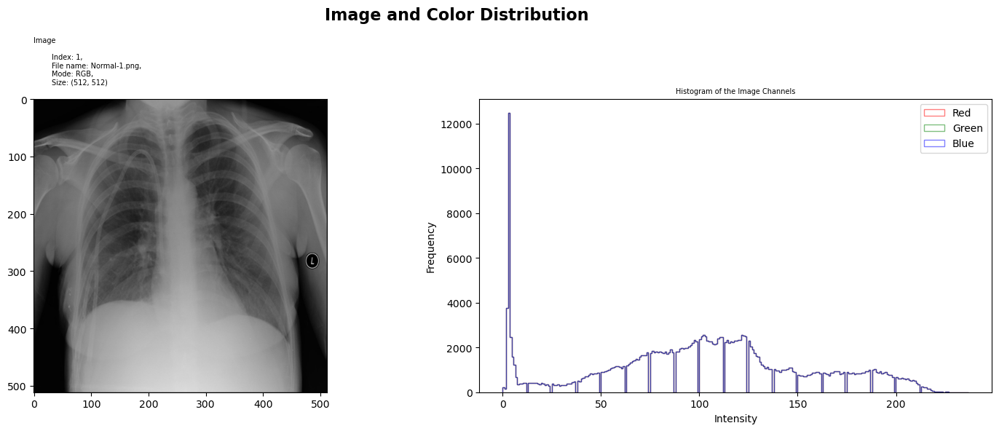

In [241]:
# Usage example:
plot_image_and_histogram(subset= 'Normal', 
                         index=1, 
                         title = "Image and Color Distribution")

**Explaination (1)**: `Image(Normal-1.png)`.Mode is `RGB`, <u>But</u>, as you can see, the histogram is displayed as a grayscale distribution. It appears that the distribution in each channel is equal.

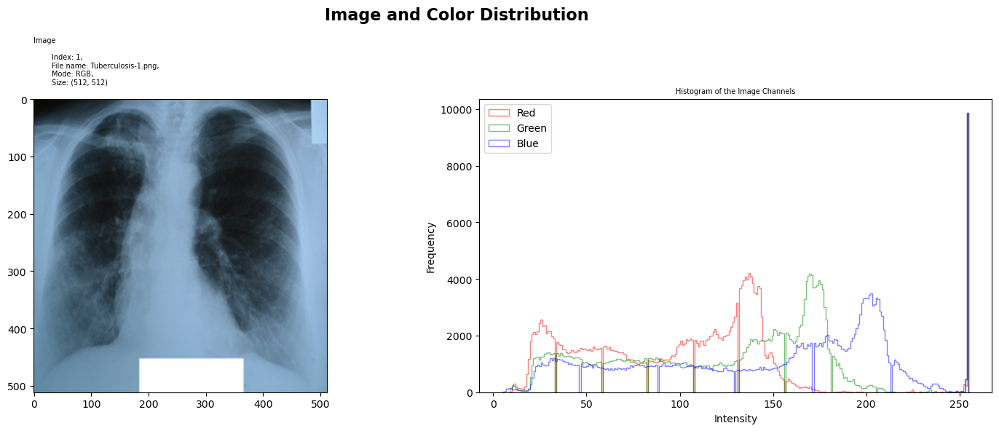

In [242]:
# Usage example:
plot_image_and_histogram(subset= 'Tuberculosis', 
                         index=1,
                         title = "Image and Color Distribution")

**Explaination (2)**: `Image(Tuberculosis-1.png)` the histogram will be separated into three channels (Red, Green, and Blue)

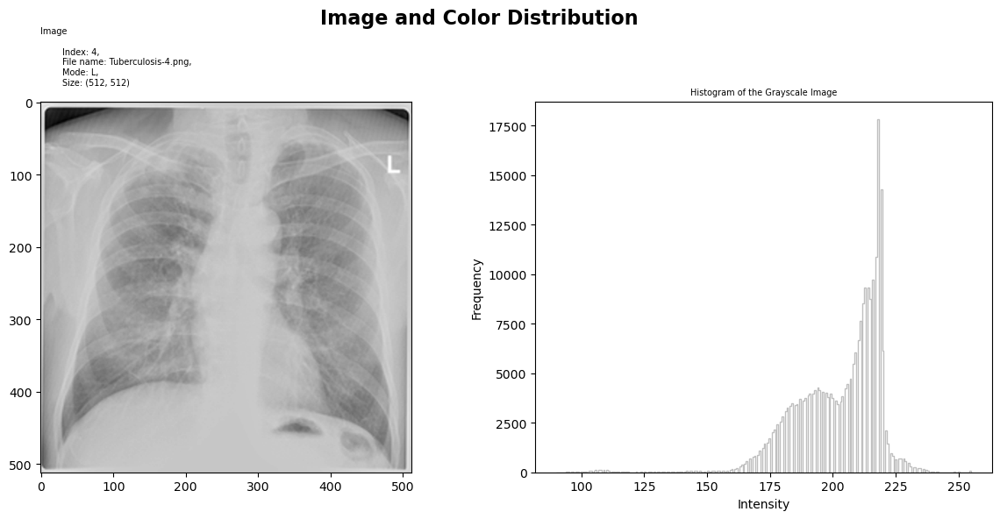

In [243]:
plot_image_and_histogram(subset= 'Tuberculosis', 
                         index=4, 
                         title = "Image and Color Distribution")

**Explaination (3)**: `Image(Tuberculosis-4.png)`.Mode is `L`, the histogram will be Gray Scale

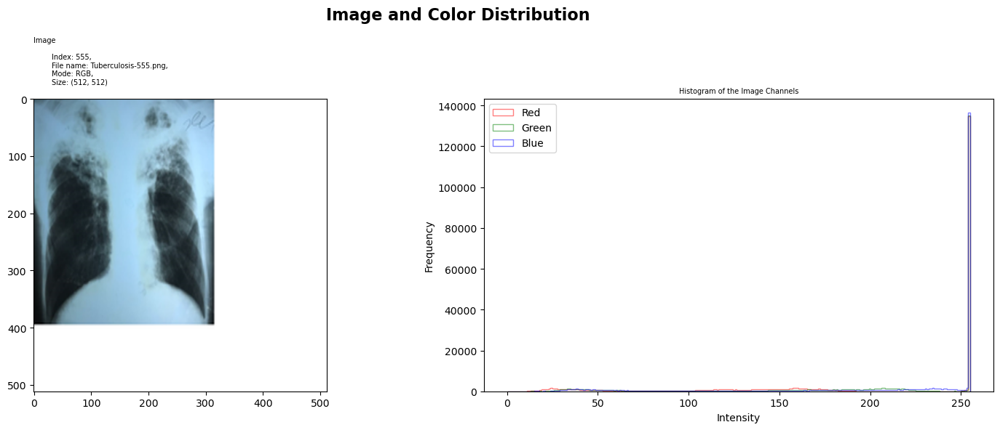

In [244]:
plot_image_and_histogram(subset= 'Tuberculosis', 
                         index=555, 
                         title = "Image and Color Distribution")

**Explaination (4)**: `Image(Tuberculosis-555.png)` contains some regions with `blank white space` that need to be removed. To achieve this, we will `remove` the blank white space and `crop` the image.

# 1. Data Preprocessing

In [245]:
import numpy as np
from numpy import asarray
import os
from tqdm import tqdm

In [246]:
def numpize(subset: str, label: int, img_size=(128, 128), grayscale=False):
    """
    Convert a set of images from a specified subset to NumPy arrays.

    Parameters:
    - subset (str): Specifies the subset of images, e.g., 'Normal' or 'Tuberculosis'.
    - label (int): Represents the label or class associated with the subset of images.
        - 'Normal'represented as 0,  
        - 'Tuberculosis' represented as 1
    - img_size (tuple): Tuple representing the desired size of the images after resizing.
    - grayscale (bool): If True, convert images to grayscale.

    Returns:
    - numpy_array (numpy.ndarray): NumPy array containing the transformed images.
    """
    image_dir = f'{dir_path}/{subset}/'
    image_files = os.listdir(image_dir)
    image_count = len(image_files)
    transformed_images = []
    labels = []
    for i in tqdm(range(1, image_count + 1), desc='Transforming...'):
        image_path = f'{image_dir}/{subset}-{i}.png'
        image = Image.open(image_path)

        # Ensure all images are in the same format
        if grayscale:
            image = image.convert('L')  # Convert to grayscale
        else:
            image = image.convert('RGB')  # Convert to RGB

        # Resize all images to the specified size without padding
        resized_image = image.resize(img_size)
        data = np.asarray(resized_image)
        # Achieve into list
        transformed_images.append(data)
        labels.append(label)

    images_numpy_array = np.array(transformed_images)
    labels_numpy_array = np.array(labels)
    return images_numpy_array, labels_numpy_array

## Normal

In [247]:
x_norm, y_norm = numpize(subset='Normal', 
               label = 0,
               img_size=(128, 128), 
               grayscale=False)
x_norm.shape

Transforming...: 100%|██████████| 3500/3500 [00:19<00:00, 181.83it/s]


(3500, 128, 128, 3)

In [248]:
y_norm.shape

(3500,)

## Tuberculosis

In [249]:
x_tb, y_tb = numpize(subset='Tuberculosis', 
             label = 1,  
             img_size=(128, 128), 
             grayscale=False)
x_tb.shape

Transforming...: 100%|██████████| 700/700 [00:03<00:00, 182.84it/s]


(700, 128, 128, 3)

In [250]:
y_tb.shape

(700,)

In [251]:
def show_image(images, target, title, num_display=16, num_cols=4, cmap='gray', random_mode=False):
    '''
    :Parameters
        images (ndarray (n,)): Input data as a numpy array.
        target (ndarray (n,)): Target data as a numpy array.
        title (String): Title of the plot.
        num_display (int): Number of images to display. Default is 16.
        num_cols (int): Number of columns in the plot. Default is 4.
        cmap (str): Color map for displaying images. Default is 'gray'.
        random_mode (bool): If True, display images randomly. If False, display the first num_display images. Default is False.
    '''
    # Determine the number of rows based on the num_cols parameter
    n_cols = min(num_cols, num_display)
    n_rows = int(np.ceil(num_display / n_cols))

    n_images = min(num_display, len(images))
    if random_mode:
        if num_display > n_images:
            print("Warning: num_display exceeds the number of available images. Setting num_display to the number of available images.")
            num_display = n_images
        random_indices = np.random.choice(
            n_images, num_display, replace=False)
    else:
        num_display = min(num_display, n_images)
        random_indices = np.arange(num_display)

    fig, axes = plt.subplots(
        nrows=n_rows, ncols=n_cols, figsize=(17, 4*n_rows))
    for i, ax in enumerate(axes.flatten()):
        index = random_indices[i]
        if i >= n_images:  # Check if the index exceeds the available number of images
            break
        else:
            image = images[index]

        ax.imshow(image, cmap=cmap)
        ax.set_title("Target: {}".format(target[index]))

        # Add image index as text
        ax.text(0.5, -0.2, f'Image Index: {index}', transform=ax.transAxes,
                fontsize=7, ha='center')

    plt.suptitle(f"{title} (Displaying {num_display} Images)",
                 fontsize=16, fontweight='bold')

    fig.set_facecolor('white')
    plt.tight_layout() 
    return plt.show()

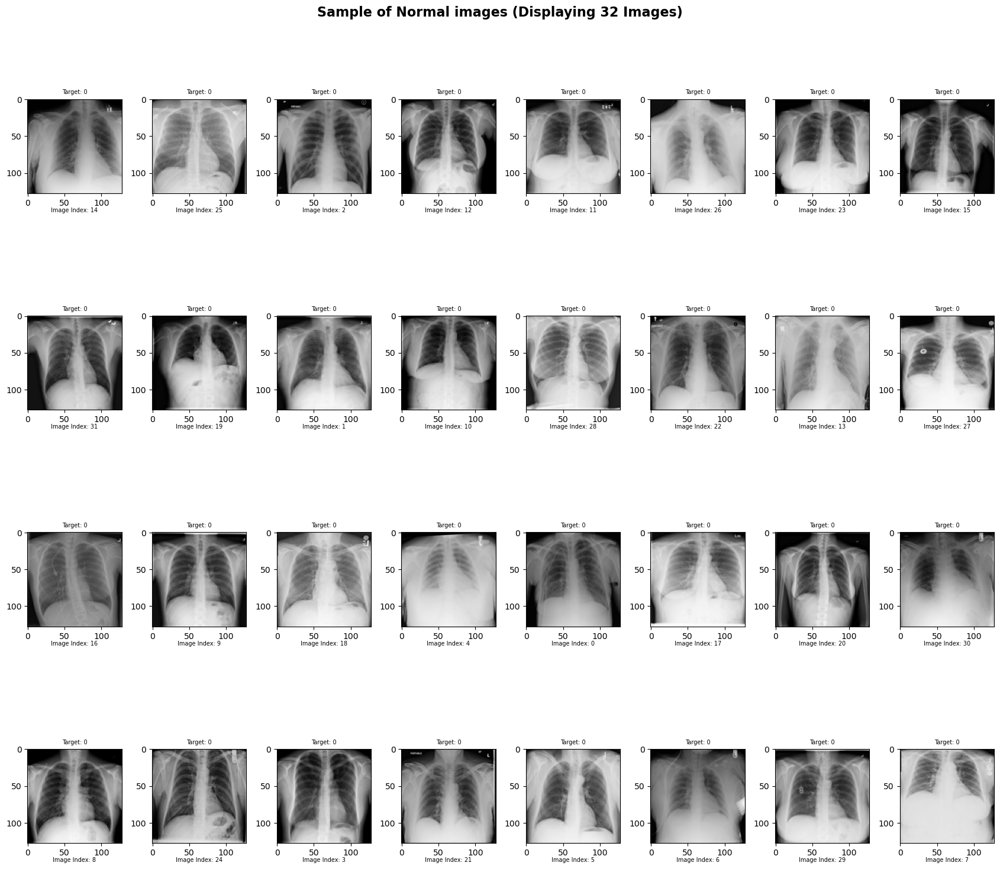

In [252]:
show_image(images=x_norm, 
           target=y_norm,
           title='Sample of Normal images',
           num_display=32, 
           num_cols=8, 
           cmap='gray', 
           random_mode=True)

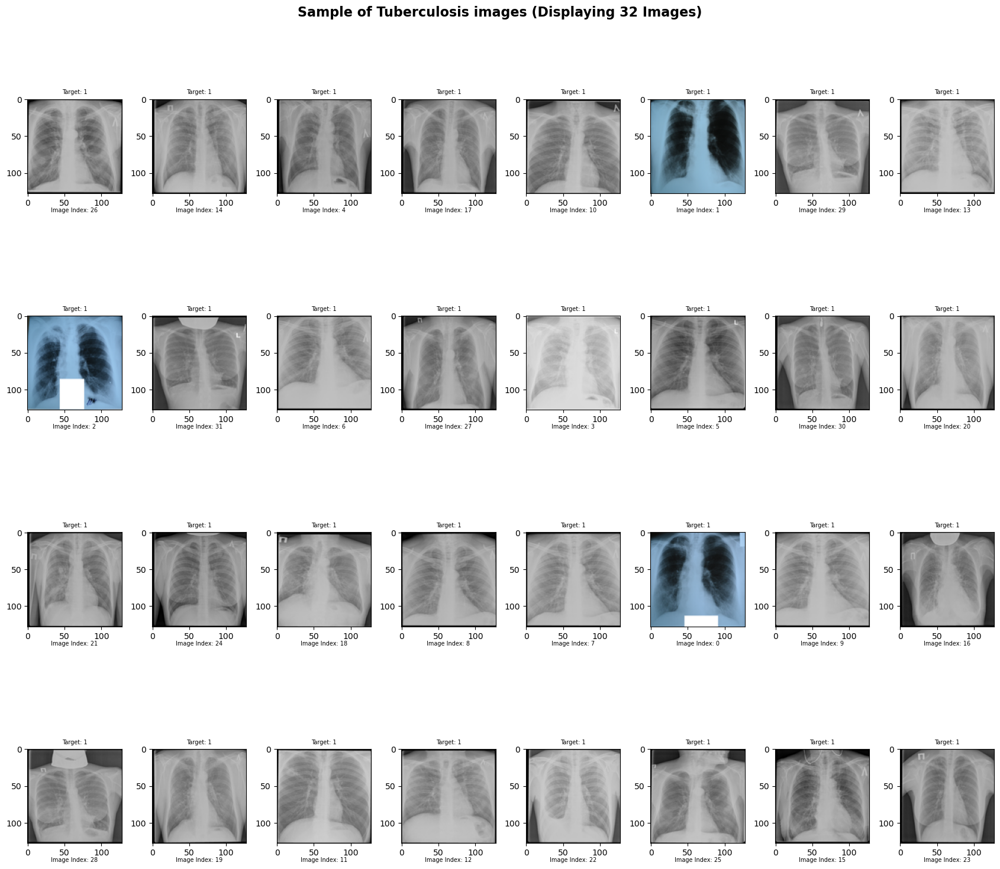

In [253]:
show_image(images=x_tb, 
           target=y_tb,
           title='Sample of Tuberculosis images',
           num_display=32, 
           num_cols=8, 
           cmap='gray', 
           random_mode=True)

In [254]:
from skimage import img_as_float
from skimage import exposure

In [255]:
def plot_gray_scale_histogram(images, titles, bins=55):
    '''
    Plot Gray Scale Histograms of Images.

    Parameters:
        - images (list): List of grayscale images to plot histograms for.
        - titles (list): List of titles for each histogram.
        - bins (int, optional): Number of bins for the histogram. Default is 100.

    Returns:
        None

    This function generates histograms for a list of grayscale images and displays them side by side. Each histogram is accompanied by its respective title.

    The function does not return any values; it displays the histogram plots directly.
    '''
    # Display results
    fig, axes = plt.subplots(2, len(images), figsize=(17, 8))

    for i, (title, image) in enumerate(zip(titles, images)):
        ax_img, ax_hist, ax_cdf, random_index = img_and_hist(
            image, axes[:, i], bins)

        mean_value = np.mean(image)
        median = np.median(image)
        percentile_95 = np.percentile(image, 95)
        std_value = np.std(image)
        min_value = np.min(image)
        max_value = np.max(image)

        ax_img.set_title('Descriptive statistics of '+r'$\bf{' + f'{title}'+'}$' +
                         f'\nMean: {mean_value: .2f}, Std: {std_value: .2f}, Median: {median: .2f},\nPercentile 95: {percentile_95: .2f}, Min: {min_value: .2f}, Max: {max_value: .2f}', fontsize=16)
        ax_img.text(0.5, -0.15, f'Image Index: {random_index}\n(Display random image)', transform=ax_img.transAxes,
                    fontsize=10, ha='center')

        y_min, y_max = ax_hist.get_ylim()
        ax_hist.set_title(
            'Distribution of pixel intensities of'+r'$\bf{' + f'{title}'+'}$', fontsize=16)
        ax_hist.set_ylabel('Number of pixels')
        ax_hist.set_yticks(np.linspace(0, y_max, 5))

        ax_cdf.set_ylabel('Fraction of total intensity')
        ax_cdf.set_yticks(np.linspace(0, 1, 5))

    plt.suptitle('Gray scale Histogram: Distribution of intensity pixel',
                 fontsize=16, fontweight='bold')
    # Prevent overlap of y-axis labels
    fig.tight_layout()
    plt.show()


def img_and_hist(image_data, axes, bins=100):
    '''
    Plot an image along with its histogram and cumulative histogram.

    Parameters:
        - image_data (ndarray): Grayscale image data as a numpy array.
        - axes (list): List of axes for displaying the image, histogram, and cumulative histogram.
        - bins (int): Number of bins for the histogram.

    Returns:
        - ax_img, ax_hist, ax_cdf: Axes objects for image, histogram, and cumulative histogram.

    This function displays an image along with its histogram and cumulative histogram. It takes the grayscale image data, a list of axes for plotting, and the number of bins for the histogram.

    The function returns the axes objects for the image, histogram, and cumulative histogram.
    '''

    '''
    Plot an image along with its histogram and cumulative histogram.
    '''
    image = img_as_float(image_data)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    random_index = np.random.randint(0, len(image_data))

    # Display image
    ax_img.imshow(image if image.shape[0] ==1 else image[random_index], cmap=plt.cm.gray)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')
    # ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # Display cumulative distribution
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf, random_index
    

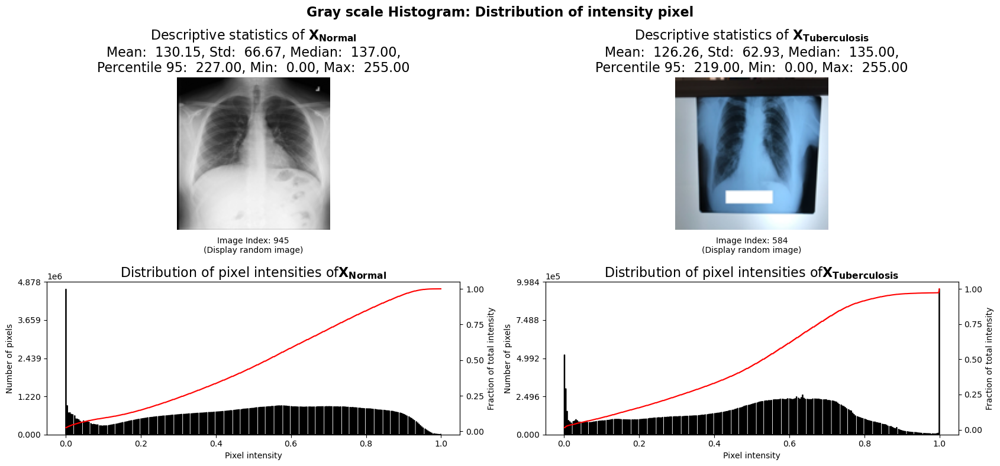

In [256]:
images = [x_norm, x_tb]
subsets = ['X_{Normal}', 'X_{Tuberculosis}']
# For visualization
"""
images: list of numpy.array
subsets: list of string
bins: integer or number that control the shape of distribution for to display
"""
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [257]:
import cv2

In [258]:
def compute_image_statistics(image):
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Compute image statistics
    mean_intensity = np.mean(gray)
    std_intensity = np.std(gray)
    median_intensity = np.median(gray)
    percentile_95 = np.percentile(gray, 95)
    
    return mean_intensity, std_intensity, median_intensity, percentile_95

def abnormal_image_identifier(images, labels, subset, thresholds):
    filtered_normal_images = []
    filtered_abnormal_images = []
    filtered_normal_labels = []
    filtered_abnormal_labels = []
    
    for image, label in zip(images, labels):
        # Compute image statistics
        mean_intensity, std_intensity, median_intensity, percentile_95 = compute_image_statistics(image)
        
        # Check if image meets filtering criteria
        if (mean_intensity > thresholds['mean_threshold'] and
            std_intensity > thresholds['std_threshold'] and
            median_intensity > thresholds['median_threshold'] and
            percentile_95 > thresholds['percentile_threshold']):
            # Image is abnormal
            filtered_abnormal_images.append(image)
            filtered_abnormal_labels.append(label)
        else:
            # Image is normal
            filtered_normal_images.append(image)
            filtered_normal_labels.append(label)
            
    summary = f"""{prefix_bold}Detected Abnormal Images{suffix_bold}
    Subset: {subset}
    Amount: {len(filtered_abnormal_images)} images
    """
    
    print(summary)
    
    return np.array(filtered_normal_images), np.array(filtered_abnormal_images), filtered_normal_labels, filtered_abnormal_labels


In [259]:
constant = 5
tb_thresholds = {
    'mean_threshold': 126-constant,  
    'std_threshold': 62-constant,   
    'median_threshold': 135-constant, 
    'percentile_threshold': 219-constant 
}

# Filter images based on thresholds
norm_tb_images, abnorm_tb_images,norm_tb_labels, abnorm_tb_labels  = abnormal_image_identifier(x_tb, y_tb, subset='Tuberculosis', thresholds=tb_thresholds)

Detected Abnormal Images
    Subset: Tuberculosis
    Amount: 67 images
    


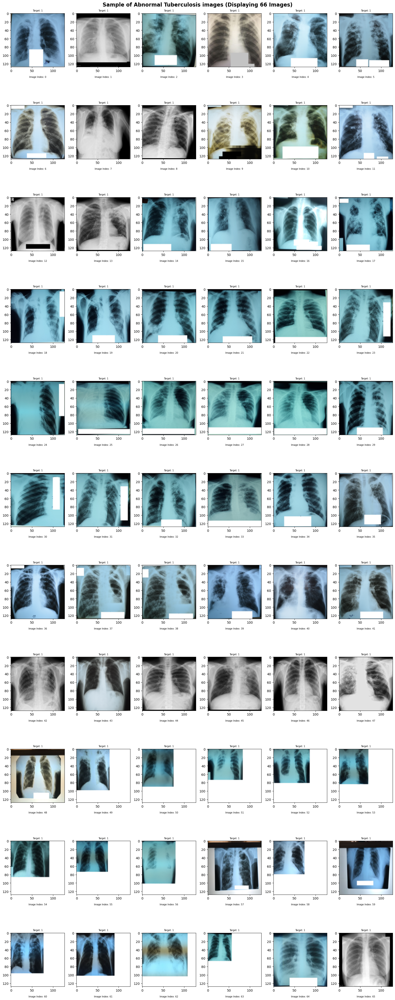

In [260]:
show_image(images=abnorm_tb_images, 
           target=abnorm_tb_labels,
           title='Sample of Abnormal Tuberculosis images',
           num_display=66, 
           num_cols=6, 
           cmap='gray', 
           random_mode=False)

In [261]:
constant = 5

norm_thresholds = {
    'mean_threshold': 130 + constant,  
    'std_threshold': 66 + constant,   
    'median_threshold': 137 +constant, 
    'percentile_threshold': 227 +constant
}

# Filter images based on thresholds
norm_norm_images, abnorm_norm_images,norm_norm_labels, abnorm_norm_labels  = abnormal_image_identifier(x_norm, y_norm, subset='Normal', thresholds=norm_thresholds)

Detected Abnormal Images
    Subset: Normal
    Amount: 77 images
    


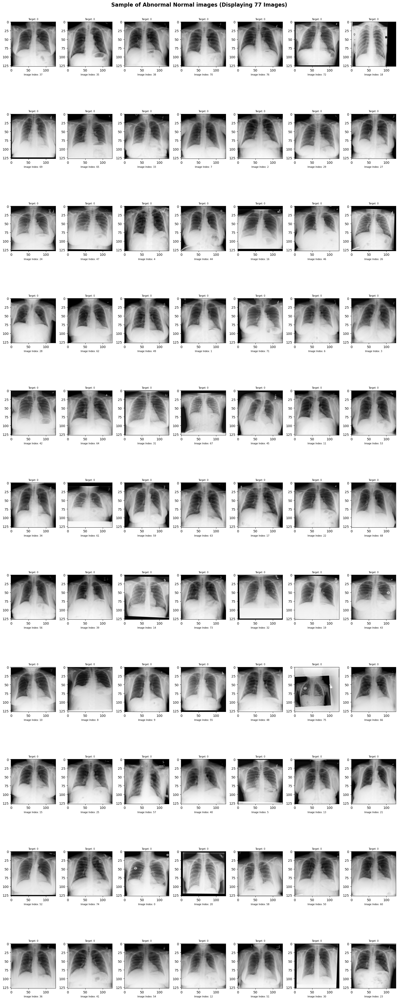

In [262]:
show_image(images=abnorm_norm_images, 
           target=abnorm_norm_labels,
           title='Sample of Abnormal Normal images',
           num_display=77, 
           num_cols=7, 
           cmap='gray', 
           random_mode=True)

In [263]:
def cv2_gray_converter(image):
    if len(image.shape) == 3:  # RGB image
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    else:  # Grayscale image
        gray = image
    return gray

In [264]:
def RBS(image,
        new_size=(128, 128), 
        init_intensity=240, 
        final_intensity=255):
    """
    RBS (Remove Blank Space):
        RBS Function: It will detect an image whether White/Black depends on range of Intensity range, Incase you want to remove:
            - White, Intensity should be 240 - 255 (Almost White) of Intensity will be selected, and remove it
            - Black,  Intensity should be 0 - 10 (Almost Black) of Intensity will be selected, and remove it
            PS, I used the 95% Percentile value of Tuberculosis group to remove the White Blank Space in their group, And padding parameter created just incase to preserve the edge of an image
    """
    # 1. Condition: To convert the image to grayscale
    gray = cv2_gray_converter(image)
    """
    How cv2.threshold works:
        ret, thresh = cv2.threshold(image, start_intensity_value, end_intensity_value, type_of_thresholding)
        Parameters:
            - image: The input grayscale image.
            - start_intensity_value: The lower threshold intensity value.
            - end_intensity_value: The upper threshold intensity value.
            - type_of_thresholding: The type of thresholding to be applied.
    Example:
        ret, thresh = cv2.threshold(image, 240, 255, cv2.THRESH_BINARY)
        Explanation: This will create a binary threshold image where pixel intensities higher than 240 are set to 255 (white).
    """
    # 2. calculate threshold
    info = f"Intensity Range: {init_intensity} to {final_intensity}"
    # 3. thresholding: 
    ret, thresh = cv2.threshold(gray, init_intensity, final_intensity, cv2.THRESH_BINARY_INV)
    
    """
    Code - Types of Thresholding:
        ret, thresh1 = cv2.threshold(img, 120, 255, cv2.THRESH_BINARY) 
        ret, thresh2 = cv2.threshold(img, 120, 255, cv2.THRESH_BINARY_INV) 
        ret, thresh3 = cv2.threshold(img, 120, 255, cv2.THRESH_TRUNC) 
        ret, thresh4 = cv2.threshold(img, 120, 255, cv2.THRESH_TOZERO) 
        ret, thresh5 = cv2.threshold(img, 120, 255, cv2.THRESH_TOZERO_INV) 
    """

    """
    Contour Approximation Method: 
        - Used to find contours in a binary image (2 colors image). 
        - Find contours, represent the boundaries of objects in an image with the same intensity or color.
    """
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
     
    # Find the contour with the largest area
    contour = max(contours, key=cv2.contourArea)

    # Find the bounding box of the contour
    x, y, w, h = cv2.boundingRect(contour)

    # Crop the original image using the bounding box
    cropped_image = image[y:y+h, x:x+w]
    cropped_image = cv2.resize(cropped_image, new_size)
    
    return cropped_image, thresh, info


In [265]:
def DCS(image, 
        padding=0, 
        init_intensity=10, 
        final_intensity=255,
        new_size=(128, 128)):
    
    """
    DCS (Detect and Crop Subject):
        DCS Function: It will detect an image input in gray where 10 - 255 of Intensity will be selected
    """
    # Convert the image to grayscale
    gray = cv2_gray_converter(image)
    
    # Apply thresholding to segment the subject (you can use more sophisticated segmentation techniques here)
    ret, thresh = cv2.threshold(gray, init_intensity, final_intensity, cv2.THRESH_BINARY)
    
    # Find contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Find the contour with the largest area
    contour = max(contours, key=cv2.contourArea)
    
    # Find the bounding box of the contour
    x, y, w, h = cv2.boundingRect(contour)
    
    # Draw a rectangle around the detected contour
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)  # Bounding box with Red color
    
    # Crop the subject with padding
    cropped_image = image[max(y - padding if (y - padding) > 0 else 0, 0):min((y + h + padding) if (y + h + padding) > 0 else 0, image.shape[0]),
                         max(x - padding if (x - padding) > 0 else 0, 0):min(x + w + padding if (x + w + padding) else 0, image.shape[1])]
    cropped_image = cv2.resize(cropped_image, new_size)
    
    return cropped_image

In [266]:
def display_after_remove(images, 
                         targets, 
                         subset, 
                         dcs_init_intensity,
                         dcs_final_intensity,
                         rbs_init_intensity,
                         rbs_final_intensity,
                         padding, 
                         
                         new_size=(128, 128), 
                         num_display=5, 
                         title='Image cropping', 
                         random_mode=False):
    cropped_images = []
    
    if random_mode:
        display_indices = np.random.choice(len(images), num_display, replace=False)
    else:
        display_indices = range(min(num_display, len(images)))
    # Image Processing and Achieve cropped images and targets or labels
    
    """
    Intensity Variables Declaration
    """
    # Black Intensity Range
    init_black_intensity = 10
    final_black_intensity = 255
    # White Intensity Range
    init_white_intensity = 214
    final_white_intensity = 255
    
    for image in images:
        
        # Detect and Crop Subject
        detected_image = DCS(image, 
                             padding=padding,
                             init_intensity=init_black_intensity, 
                             final_intensity=final_black_intensity,
                             new_size=new_size)
        
        # Remove white
        cropped_image, thresh, info = RBS(detected_image,
                                                         new_size=new_size, 
                                                         init_intensity=init_white_intensity, 
                                                         final_intensity=final_white_intensity, 
                                                         )
        cropped_images.append(cropped_image)
        
    # Image Visualization: helps visualize the regions that will be cropped.
    for idx in display_indices:
        uncropped_image = images[idx]
        label = targets[idx]
        
        
        # Detect and Crop Subject
        detected_image = DCS(uncropped_image, 
                             padding=padding,
                             init_intensity=init_black_intensity, 
                             final_intensity=final_black_intensity,
                             new_size=new_size)
        
        # Remove white
        cropped_image, thresh, info = RBS(detected_image,
                                                         new_size=new_size, 
                                                         init_intensity=init_white_intensity, 
                                                         final_intensity=final_white_intensity, 
                                                         )
        prefix_bold = r'$\bf{'
        suffix_bold = '}$'
        
        uncropped_title = f"""
            Mode: {Image.fromarray(uncropped_image).mode},
            Size: {Image.fromarray(uncropped_image).size}
            """
        cropped_title = f"""
            Mode: {Image.fromarray(cropped_image).mode},
            Size: {Image.fromarray(cropped_image).size}
            """
        plt.figure(figsize=(12, 6))
        plt.rcParams['axes.titlesize'] = 7

        plt.subplot(1, 4, 1)
        plt.imshow(uncropped_image)
        plt.title(f'{prefix_bold}Input{suffix_bold}: Original Image' + '\n' + uncropped_title, loc='left')

        plt.subplot(1, 4, 2)
        plt.imshow(detected_image)
        plt.title(f'{prefix_bold}Subject-Detection{suffix_bold}\nDetected Subject on Image: \nThreshold + Contours,\nCropping + ({padding}) Padding ')

        plt.subplot(1, 4, 3)
        plt.imshow(thresh, cmap='RdYlGn')
        plt.title(f"{prefix_bold}Threshold-Image{suffix_bold}\n{info}", fontsize=7)

        plt.subplot(1, 4, 4)
        plt.imshow(cropped_image)
        plt.title(f'{prefix_bold}Output{suffix_bold}: Cropped Image' + '\n' + cropped_title, loc='left')

        plt.suptitle(title + f"\n{prefix_bold}Subset{suffix_bold}: {subset}", font='bold')
        plt.show()
        
    return np.array(cropped_images), targets

In [267]:
tb_thresholds

{'mean_threshold': 121,
 'std_threshold': 57,
 'median_threshold': 130,
 'percentile_threshold': 214}

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


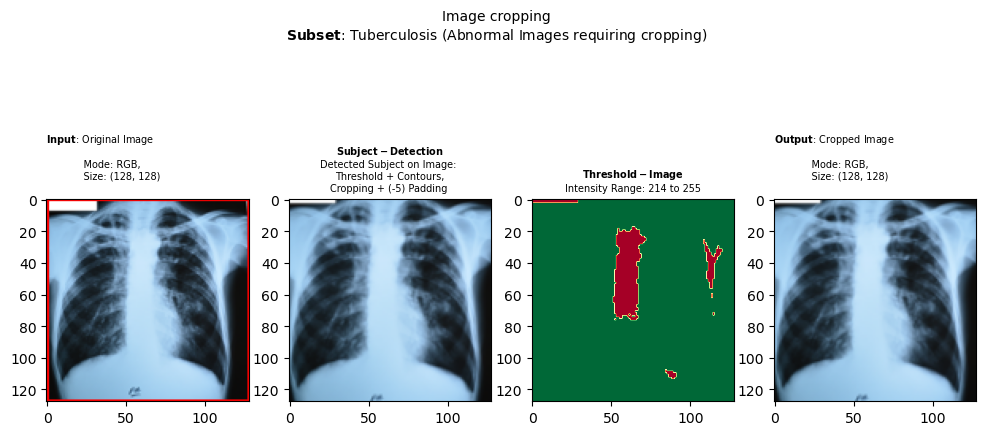

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


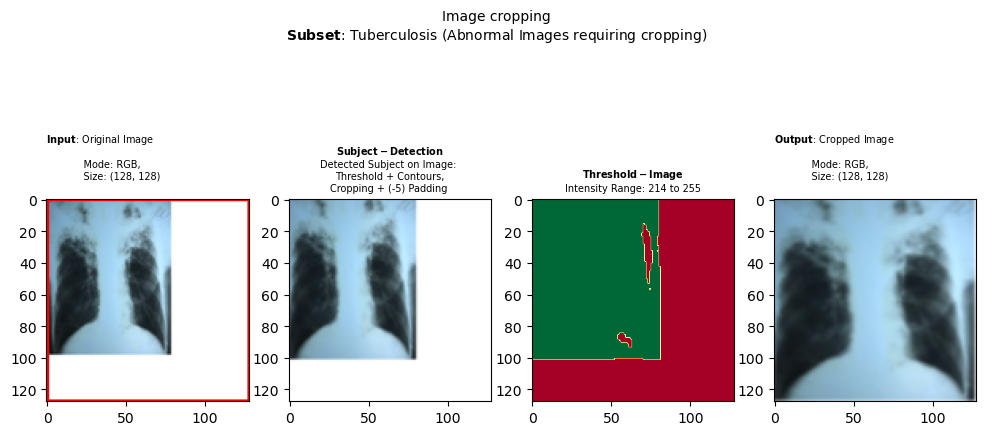

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


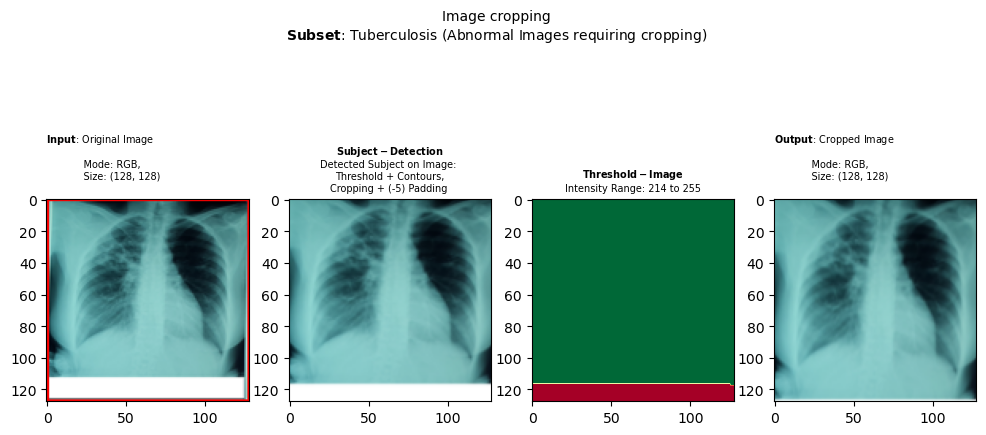

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


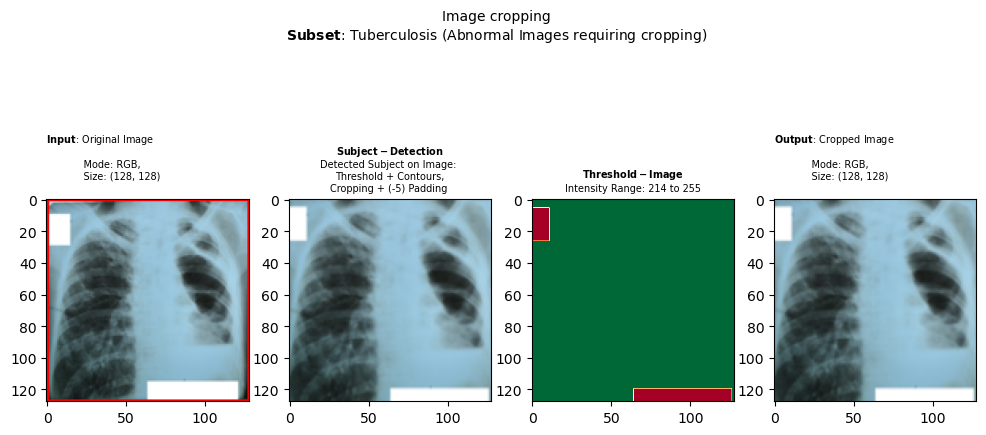

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


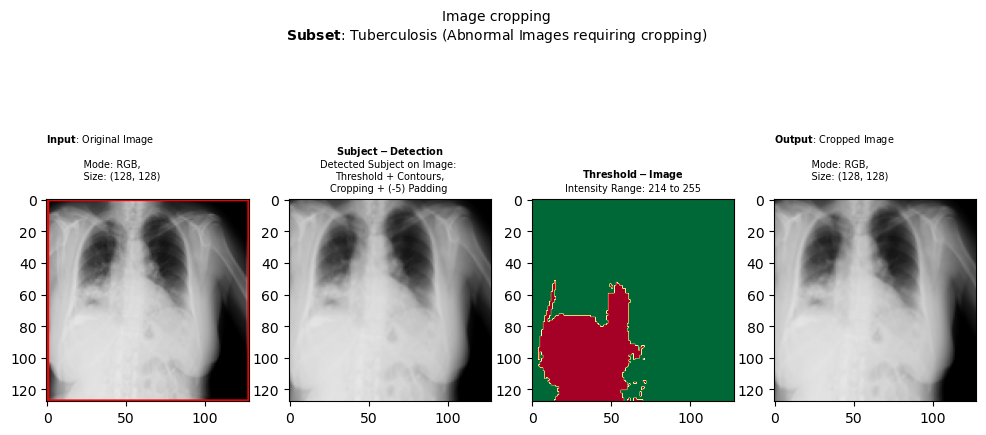

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


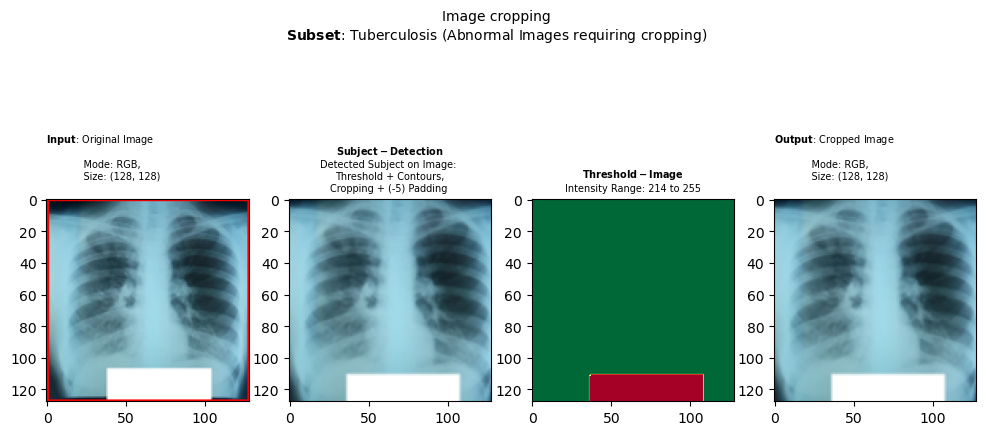

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


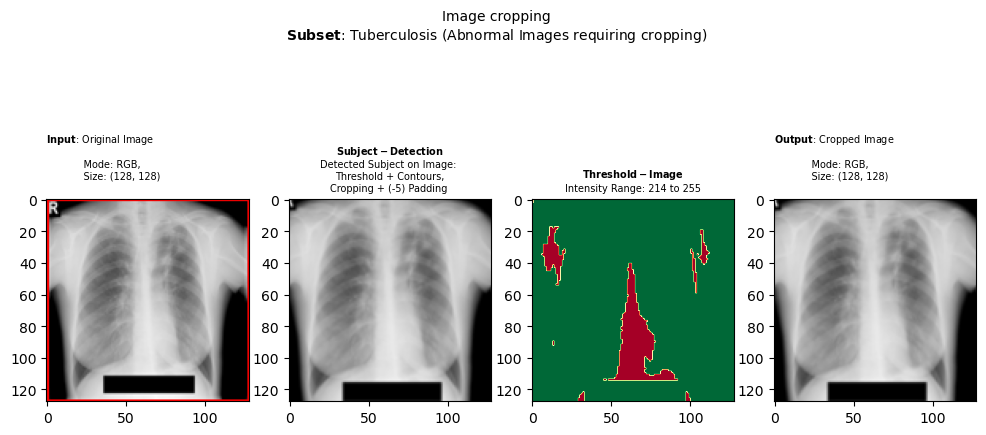

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


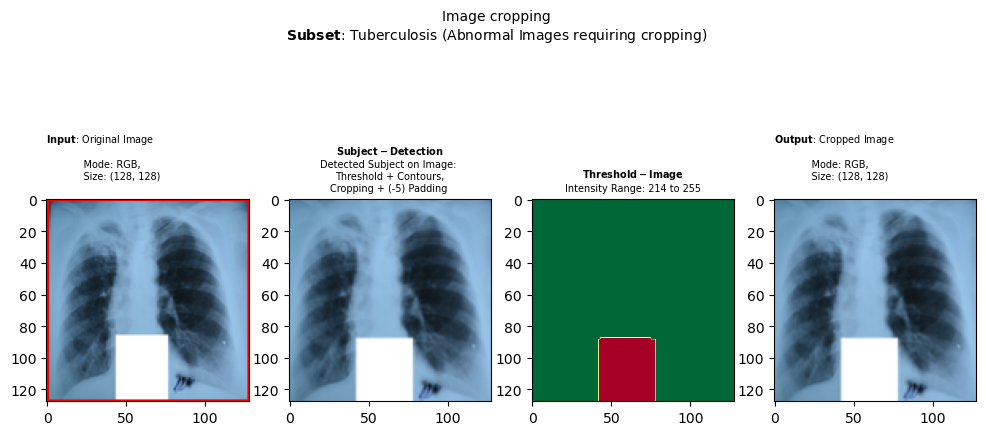

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


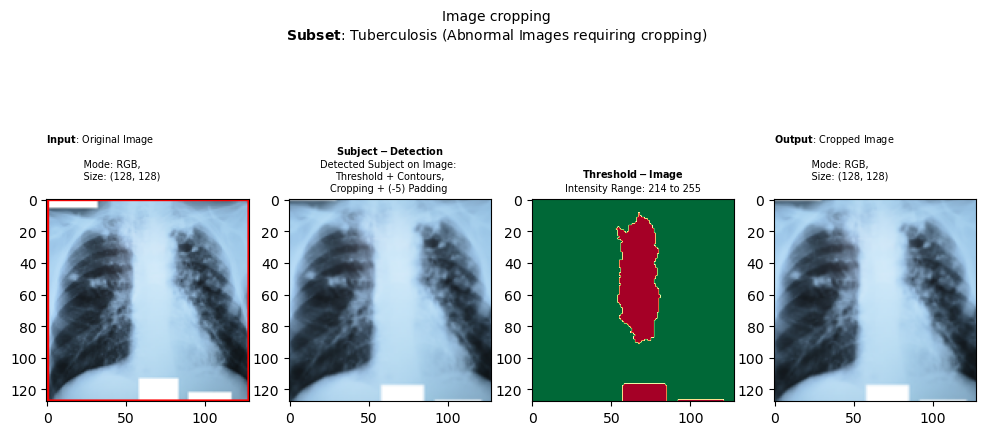

findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.
findfont: Font family 'bold' not found.


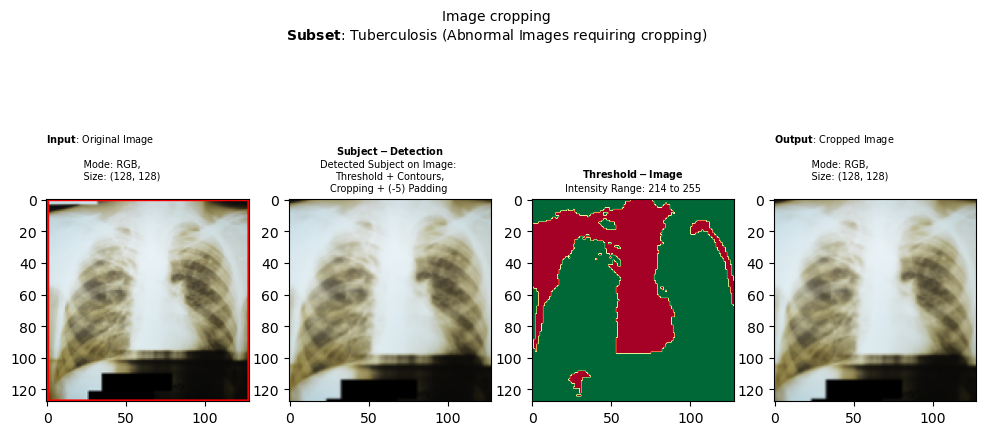

In [268]:
tb_cropped_images, tb_cropped_labels = display_after_remove(images=abnorm_tb_images, 
                                              targets=abnorm_tb_labels, 
                                              subset="Tuberculosis (Abnormal Images requiring cropping)",
                                              dcs_init_intensity=10,
                                              dcs_final_intensity=255,
                                              rbs_init_intensity=tb_thresholds['percentile_threshold'],
                                              rbs_final_intensity=255,
                                              padding=-5,
                                              new_size=(128, 128), 
                                              num_display=10, 
                                              title='Image cropping', 
                                              random_mode=True)

In [269]:
tb_cropped_images.shape

(67, 128, 128, 3)

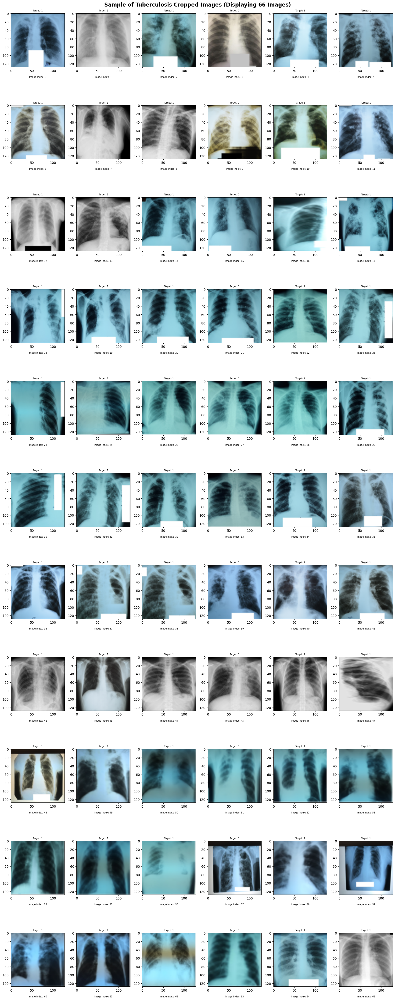

In [270]:
show_image(images=tb_cropped_images, 
           target=tb_cropped_labels,
           title='Sample of Tuberculosis Cropped-Images',
           num_display=66, 
           num_cols=6, 
           cmap='gray', 
           random_mode=False)

In [271]:
# Concatenate 
X_tb = np.concatenate((norm_tb_images, tb_cropped_images), axis=0)

# Concatenate 
y_tb = np.concatenate((norm_tb_labels, tb_cropped_labels), axis=0)

In [272]:
X_tb.shape

(700, 128, 128, 3)

In [273]:
y_tb.shape

(700,)

In [274]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import random
import time

In [275]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def x_ray_image_augmentation(images, targets, sample_count=3500):
    datagen = ImageDataGenerator(
        rotation_range=15,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    augmented_images = []
    augmented_labels = []

    i = 0
    for x, y in zip(images, targets):
        x = x.reshape((1,) + x.shape)  # Reshape to (1, height, width, channels)
        for batch in datagen.flow(x, batch_size=1):
            augmented_images.append(batch[0])
            augmented_labels.append(y)
            i += 1
            if i >= sample_count:
                break
        if i >= sample_count:
            break

    return zip(augmented_images, augmented_labels)


In [276]:
augmented_data = list(x_ray_image_augmentation(images=X_tb, targets=y_tb, sample_count=3500))
print("Augmented sample count:", len(augmented_data))

X_tb_augmented, y_tb_augmented = [], []

for image, label in augmented_data:
    X_tb_augmented.append(image)
    y_tb_augmented.append(label)

X_tb_augmented = np.stack(X_tb_augmented, axis=0)
y_tb_augmented = np.stack(y_tb_augmented, axis=0)

print(X_tb_augmented.shape)


Augmented sample count: 3500
(3500, 128, 128, 3)


In [277]:
# Scaled the subset of dataset before do Augmentation 
X_tb = X_tb/255

# So do the others
x_norm = x_norm/255

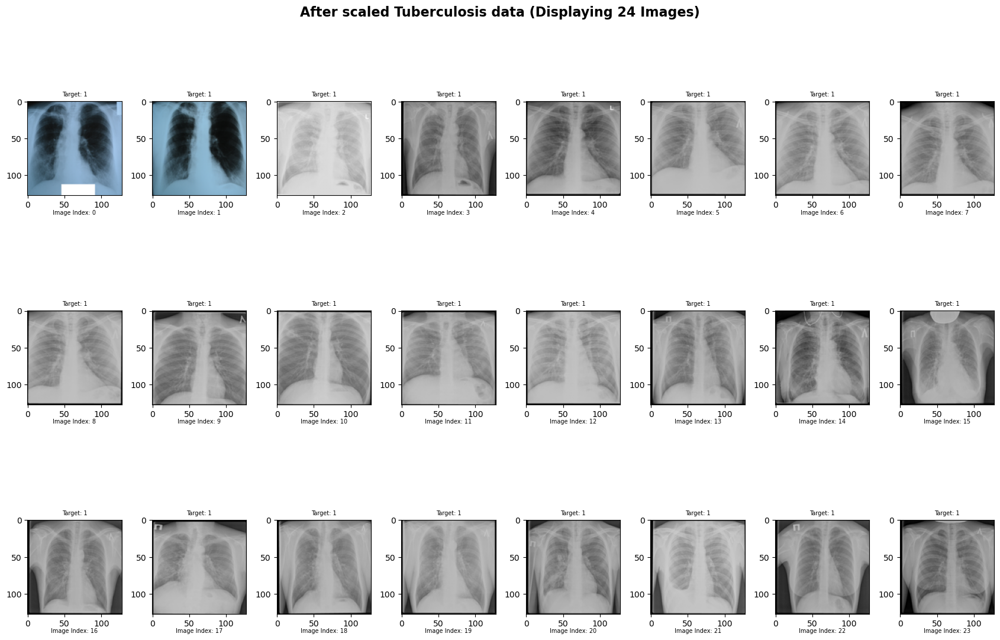

In [278]:
show_image(images=X_tb,
           target=y_tb,
           title='After scaled Tuberculosis data', 
           num_display=24, 
           num_cols=8, 
           cmap='gray', 
           random_mode=False)

In [279]:
# Ensure augmented_data_generator is defined
augmented_data_generator = x_ray_image_augmentation(images=X_tb, targets=y_tb, sample_count=3500)


In [280]:
X_tb_augmented.shape

(3500, 128, 128, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [6.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [7.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [17.759403..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [6.867503..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [9.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [17.441622..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [17.870909..255.0].
Clipping input data to the valid range 

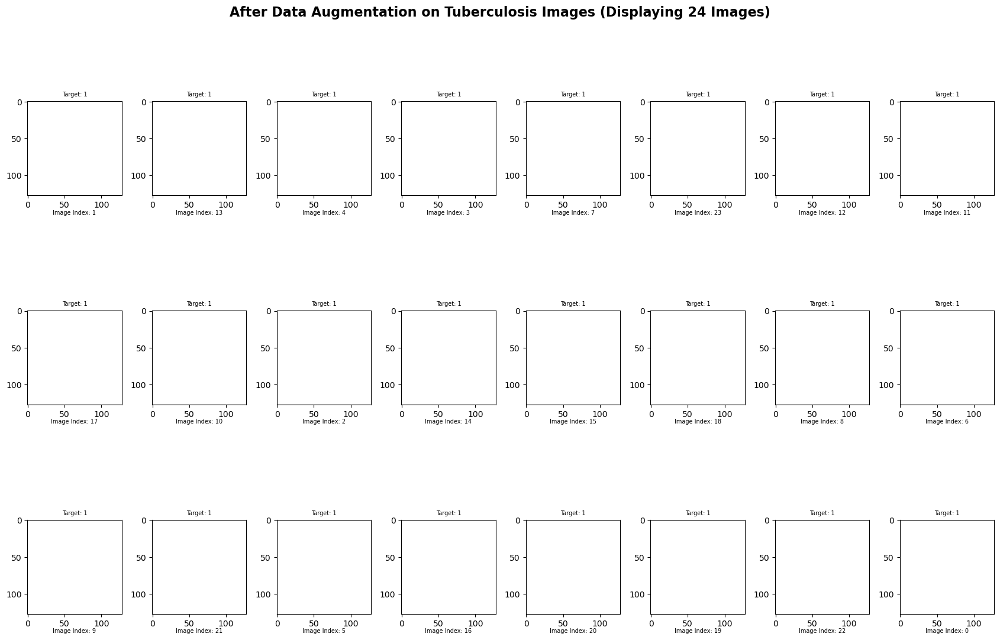

In [281]:
# New image indexes, started at 700-3500
start_index = 700
end_index = 3500

show_image(images=X_tb_augmented[start_index:end_index],
           target=y_tb_augmented[start_index:end_index],
           title='After Data Augmentation on Tuberculosis Images', 
           num_display=24, 
           num_cols=8, 
           cmap='gray', 
           random_mode=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [6.0..255.0].


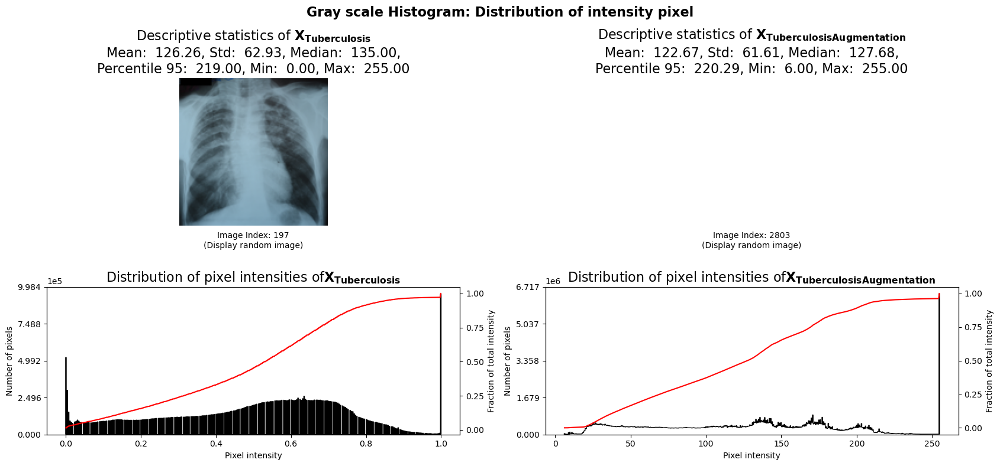

In [282]:
images_2 = [x_tb, X_tb_augmented]
subsets_2 = ['X_{Tuberculosis}', 'X_{TuberculosisAugmentation}']
# For visualization
plot_gray_scale_histogram(images=images_2, titles=subsets_2, bins=555)

In [283]:
# Concatenate x_norm and x_tb along the first axis (samples)
X_imbalanced = np.concatenate((x_norm, X_tb), axis=0)

# Concatenate y_norm and target_tb
y_imbalanced = np.concatenate((y_norm,  y_tb), axis=0)

In [284]:
X_imbalanced.shape

(4200, 128, 128, 3)

In [285]:
y_imbalanced.shape

(4200,)

In [286]:
np.bincount(y_imbalanced)

array([3500,  700])

In [287]:
X_over_sampling = np.concatenate((x_norm, X_tb_augmented), axis=0)
y_over_sampling = np.concatenate((y_norm,  y_tb_augmented), axis=0)

In [288]:
X_over_sampling.shape

(7000, 128, 128, 3)

In [289]:
y_over_sampling.shape

(7000,)

In [290]:
np.bincount(y_over_sampling)

array([3500, 3500])

In [291]:
def Undersampling(x_majority, y_majority, x_minority, y_minority, replacement=False):
    # Determine the size of the minority class
    num_samples_minority = len(y_minority)

    # Randomly select a subset of samples from the majority class to match the size of the minority class
    selected_indices_majority = np.random.choice(np.arange(len(y_majority)), size=num_samples_minority, replace=replacement)

    # Undersampled majority class data
    x_majority_resampled = x_majority[selected_indices_majority]
    y_majority_resampled = y_majority[selected_indices_majority]

    # Combine 
    x_resampled = np.concatenate((x_majority_resampled, x_minority))
    y_resampled = np.concatenate((y_majority_resampled, y_minority))

    return x_resampled, y_resampled

In [292]:
X_norm_undersampled, y_norm_undersampled = Undersampling(x_norm, y_norm, x_tb, y_tb)

In [293]:
# Print the shapes of the undersampled data
print("Undersampled x_norm shape:", X_norm_undersampled.shape)
print("Undersampled y_norm shape:", y_norm_undersampled.shape)

Undersampled x_norm shape: (1400, 128, 128, 3)
Undersampled y_norm shape: (1400,)


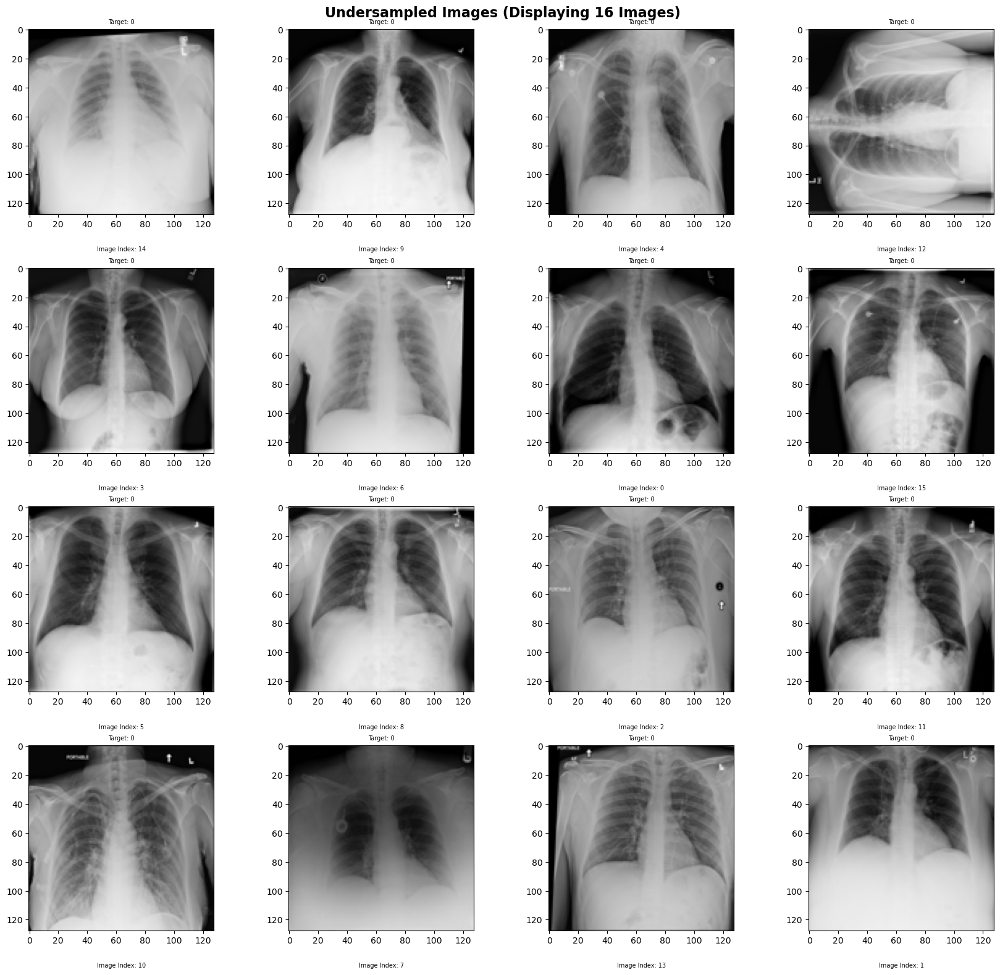

In [294]:
show_image(images=X_norm_undersampled,
           target=y_norm_undersampled,
           title='Undersampled Images', 
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

In [295]:
from skimage import exposure

In [296]:
def contrast_stretching(X):
    p2, p98 = np.percentile(X, (2, 98))
    stretched_img = exposure.rescale_intensity(X, in_range=(p2, p98))
    return stretched_img

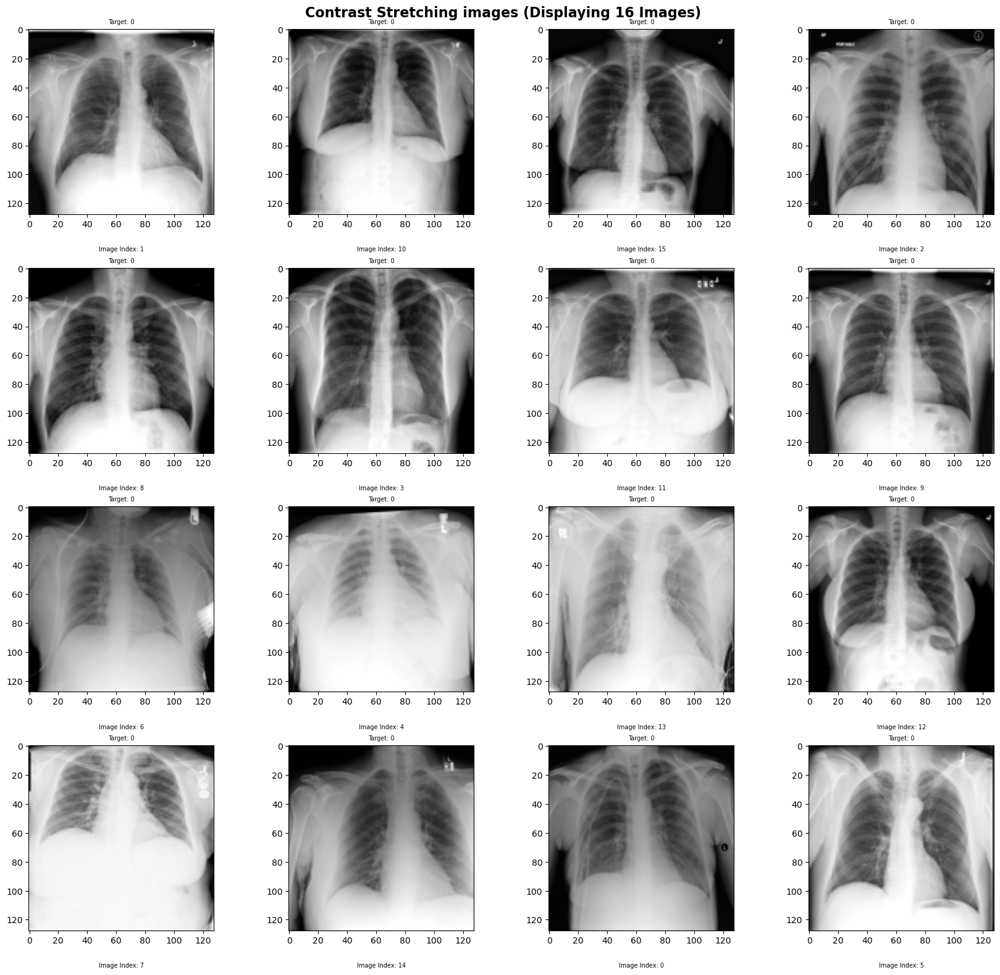

In [297]:
X_stretched = contrast_stretching(X_imbalanced[0:16])
y_stretched = y_imbalanced[0:16]
show_image(images=X_stretched,
           target=y_stretched,
           title='Contrast Stretching images', 
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

In [298]:
def equalization(X):
    eq_img = exposure.equalize_hist(X)
    return eq_img

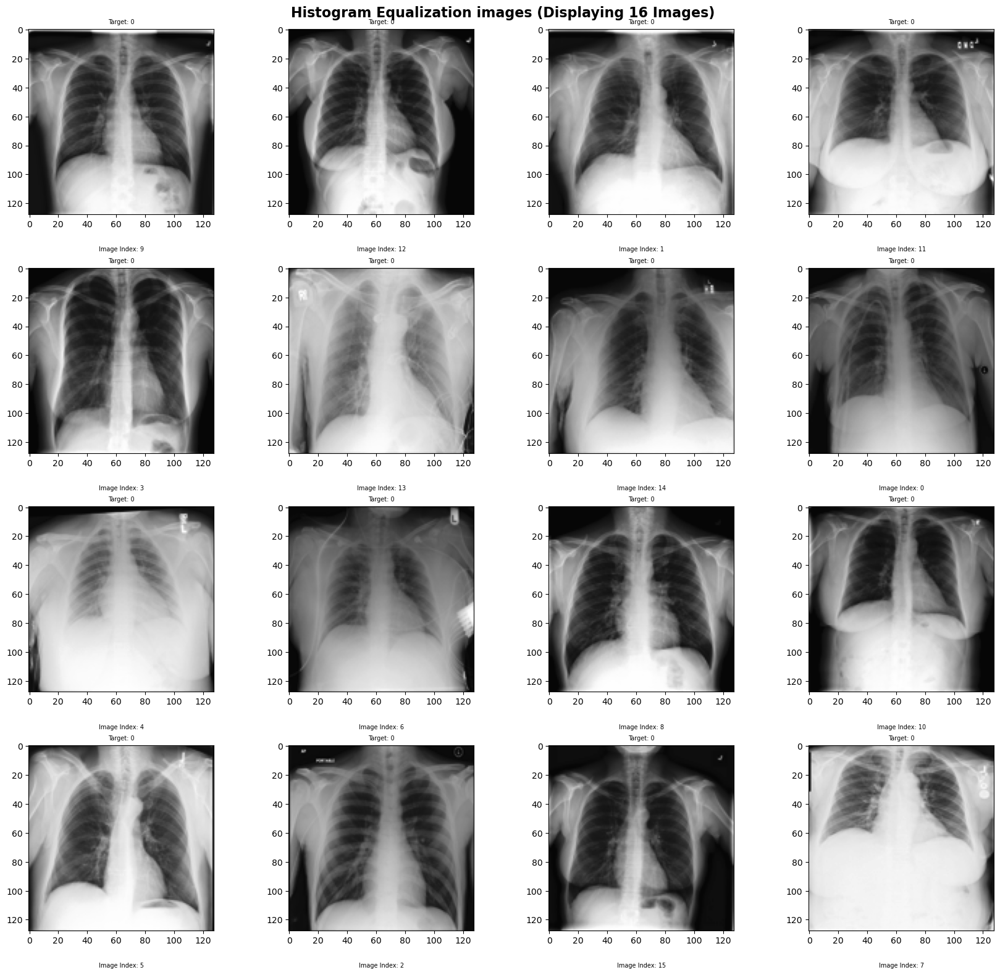

In [299]:
X_eq = equalization(X_imbalanced[0:16])
y_eq = y_imbalanced[0:16]
show_image(images=X_eq,
           target=y_eq,
           title='Histogram Equalization images', 
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

Usage example: 
``` python
def adaptive_equalization(X, clip_limit):
    '''
    :Parameters:
    X (ndarray (n,)): Input data as a numpy array, X.shape should be (128, 128, 1)
    clip_limit (int or float): used to control the contrast
    '''
    # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization
    X_normalized = (X - np.min(X)) / (np.max(X) - np.min(X))
    X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
    adapteq_img = exposure.equalize_adapthist(
        X_normalized, clip_limit=clip_limit)

    return adapteq_img

```

> Note: I added '**batch_size**' parameter, Because of computational and memory constraints.

In [300]:
def adaptive_equalization(X, clip_limit, batch_size=None):
    '''
    :Parameters:
    X (ndarray (n,)): Input data as a numpy array, X.shape should be (128, 128, 1)
    clip_limit (int or float) (default is  0.01): used to control the contrast, normalized between 0 and 1 (higher values give more contrast). 
    batch_size (int): Size of the batch to process. If None, the entire input is processed at once.
    '''
    if batch_size is None:
        # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization
        X_normalized = (X - np.min(X)) / (np.max(X) - np.min(X))
        X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
        adapteq_img = exposure.equalize_adapthist(
            X_normalized, clip_limit=clip_limit)
    else:
        # Process data in batches
        num_batches = int(np.ceil(len(X) / batch_size))
        batch_results = []

        for i in tqdm(range(num_batches),desc='processing...'):
            start_idx = i * batch_size
            end_idx = min((i + 1) * batch_size, len(X))

            # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization for each batch
            X_normalized = (X[start_idx:end_idx] - np.min(X[start_idx:end_idx])) / \
                (np.max(X[start_idx:end_idx]) - np.min(X[start_idx:end_idx]))
            X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
            adapteq_img_batch = exposure.equalize_adapthist(
                X_normalized, clip_limit=clip_limit)
            batch_results.append(adapteq_img_batch)

        # Concatenate the batch results
        adapteq_img = np.concatenate(batch_results, axis=0)

    return adapteq_img

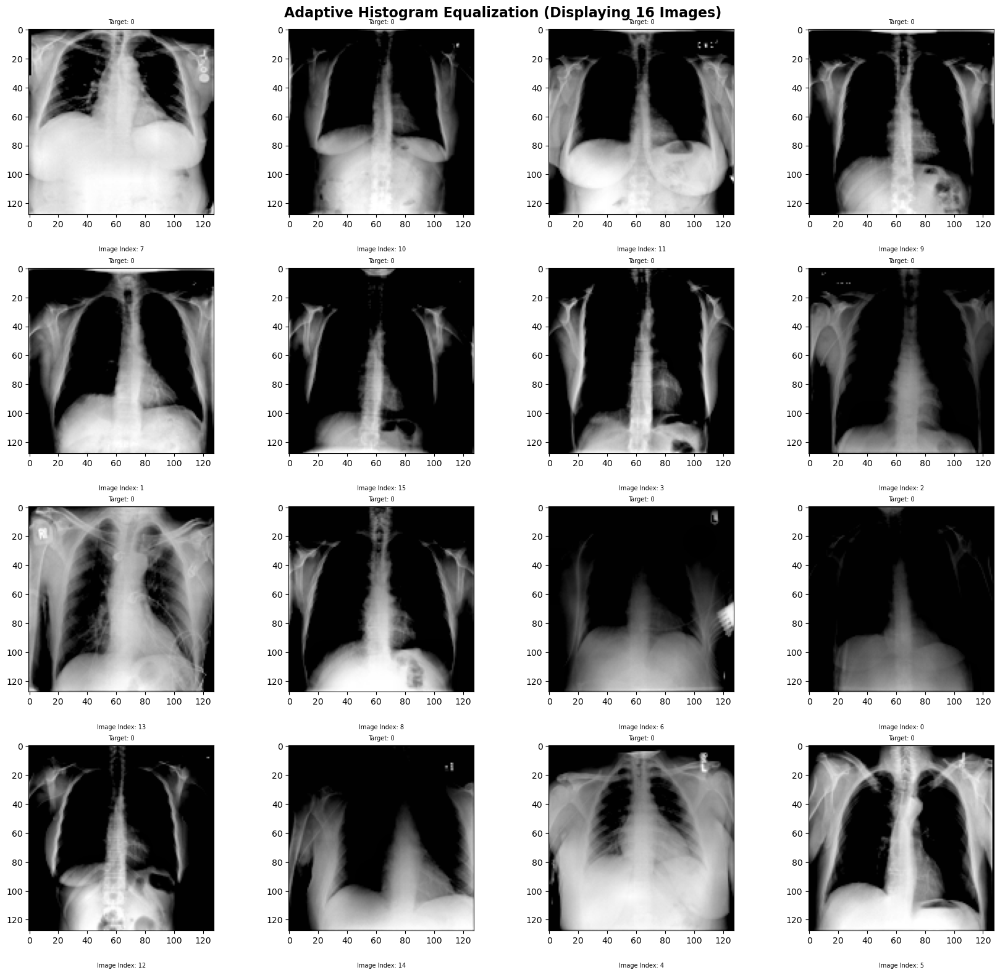

In [301]:
X_adapteq = adaptive_equalization(X_imbalanced[0:16], 0.01)
y_adapteq = y_imbalanced[0:16]
show_image(images=X_adapteq,
            target=y_adapteq,
            title='Adaptive Histogram Equalization', 
            num_display=16, 
            num_cols=4, 
            cmap='gray', 
            random_mode=True)

In [302]:
sample = X_imbalanced[0,:,:,:]
sample.shape

(128, 128, 3)

In [303]:
# 1. Load a normal image
img = sample

# 2. Contrast stretching
img_cs = contrast_stretching(img)

# 3. Histogram Equalization
img_eq = equalization(img)

# 4. Adaptive Equalization
img_adapteq = adaptive_equalization(img, 0.01)

methods = ['Low contrast image', 'Contrast stretching',
           'Histogram equalization', 'Adaptive equalization']
images_3 = [img, img_cs, img_eq, img_adapteq]

/opt/anaconda3/lib/python3.12/site-packages/skimage/_shared/utils.py:438: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


In [304]:
def img_and_hist_single_img(image, axes, bins=100):
    '''
    Plot an image along with its histogram and cumulative histogram.
    '''
    image = img_as_float(image)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # Display image
    ax_img.imshow(image, cmap=plt.cm.gray)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')
    # ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # Display cumulative distribution
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf

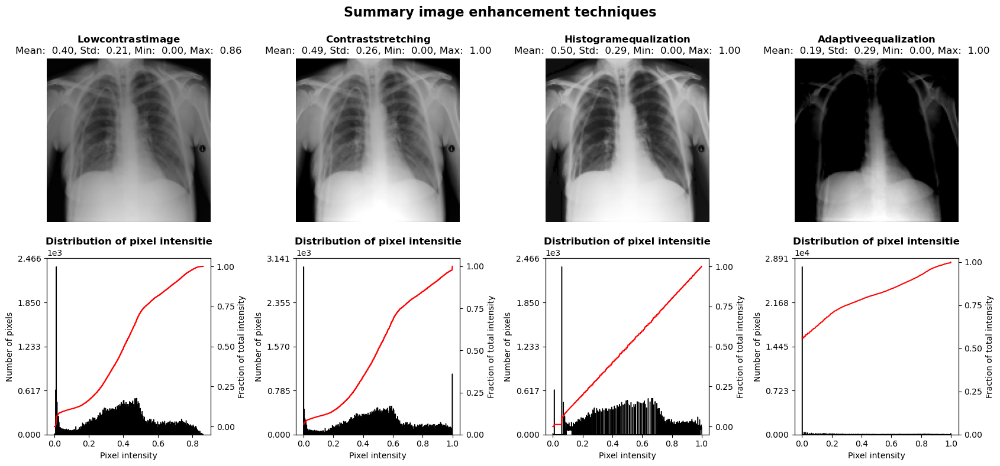

In [305]:
# Display results
fig, axes = plt.subplots(2, 4, figsize=(17, 8))

for i, (method, image) in enumerate(zip(methods, images_3)):
    ax_img, ax_hist, ax_cdf = img_and_hist_single_img(image, axes[:, i], bins=555)

    mean_value = np.mean(image)
    std_value = np.std(image)
    min_value = np.min(image)
    max_value = np.max(image)

    ax_img.set_title(
        r'$\bf{' + f'{method}'+'}$'+f'\nMean: {mean_value: .2f}, Std: {std_value: .2f}, Min: {min_value: .2f}, Max: {max_value: .2f}', fontsize=12)

    y_min, y_max = ax_hist.get_ylim()
    ax_hist.set_title(
        'Distribution of pixel intensitie', fontsize=12, fontweight='bold')
    ax_hist.set_ylabel('Number of pixels')
    ax_hist.set_yticks(np.linspace(0, y_max, 5))

    ax_cdf.set_ylabel('Fraction of total intensity')
    ax_cdf.set_yticks(np.linspace(0, 1, 5))

plt.suptitle('Summary image enhancement techniques',
             fontsize=16, fontweight='bold')
fig.tight_layout()
plt.show()

In [306]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, Flatten, Dropout, Dense
from sklearn.model_selection import KFold
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.metrics import accuracy_score

In [307]:
class CNN(BaseEstimator, ClassifierMixin):
    def __init__(self, 
                 # CNN Architecture
                 input_shape=(128, 128, 3), 
                 unit_multiplier=1.0, 
                 # CNN Hyperparameters
                 conv_padding='same', 
                 conv_kernel_size=(3, 3),
                 conv_stride=1, 
                 pool_padding='same', 
                 pool_kernel_size=(2, 2), 
                 pool_stride=2, 
                 dropout=0, 
                 l1_lambda=None,
                 l2_lambda=None, 
                 pooling_type='max', 
                 # Adam Optimizer Configuration (Default)
                 learning_rate=0.001,
                 beta1=0.9,
                 beta2=0.999,
                 epsilon=1e-07,
                 # Training Configuration
                 batch_size=32,
                 epochs=10,
                 verbose=0,
                 metrics=['accuracy'],
                 ):
        
        self.input_shape = input_shape
        self.unit_multiplier = unit_multiplier
        self.conv_padding = conv_padding
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.pool_padding = pool_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.dropout = dropout
        self.l1_lambda = l1_lambda
        self.l2_lambda = l2_lambda
        self.pooling_type = pooling_type
        self.learning_rate=learning_rate
        self.beta1=beta1
        self.beta2=beta2
        self.epsilon=epsilon
        self.metrics = metrics
        self.batch_size=batch_size
        self.epochs = epochs
        self.verbose = verbose
        self.model = self.architecturize()

    def architecturize(self):
        reg_l1 = None
        reg_l2 = None

        if self.l1_lambda is not None:
            reg_l1 = tf.keras.regularizers.l1(self.l1_lambda)

        if self.l2_lambda is not None:
            reg_l2 = tf.keras.regularizers.l2(self.l2_lambda)

        model = Sequential()
        model.add(Conv2D(
            int(32 * self.unit_multiplier),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            activation='relu',
            kernel_regularizer=reg_l1,
            input_shape=self.input_shape))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Conv2D(
            int(64 * self.unit_multiplier),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            kernel_regularizer=reg_l2,
            activation='relu'))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Conv2D(
            int(128 * self.unit_multiplier),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            kernel_regularizer=reg_l2,
            activation='relu'))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Flatten())
        model.add(Dense(
            units=int(128 * self.unit_multiplier),
            activation='relu',
            kernel_regularizer=reg_l2))

        model.add(Dropout(self.dropout))
        model.add(Dense(units=1, activation='sigmoid'))
        
        # Adam Optimizer Algorithm
        self.optimizer = tf.keras.optimizers.Adam(
                learning_rate=self.learning_rate,
                beta_1= self.beta1,
                beta_2= self.beta2,
                epsilon=self.epsilon,
            )
        model.compile(loss='binary_crossentropy',
                      optimizer=self.optimizer,
                      metrics=self.metrics)
    
        return model

    def predict_(self, X, threshold=0.5):

        probabilities = self.model.predict(X, verbose=self.verbose)
        binary_predictions = (probabilities > threshold).astype("int32")
        return binary_predictions, probabilities
    
    def fit(self, X, y):
        self.model.fit(X, y, epochs=self.epochs, batch_size=self.batch_size, verbose=self.verbose)
        return self
    
    def predict(self, X):
        return self.model.predict(X)

    def score(self, X, y):
        y_pred = self.predict(X)
        return accuracy_score(y, y_pred)
    
    def summary(self):
        self.model.summary()
        
    def cv(self, X, y, epochs=10, batch_size=16, cv=5, verbose=1):
        kf = KFold(n_splits=cv, shuffle=True)
        scores = []
        for train_index, test_index in kf.split(X):
            X_train, X_test = X[train_index], X[test_index]
            y_train, y_test = y[train_index], y[test_index]
            self.model.fit(X_train, y_train, epochs=epochs if epochs else self.epochs, batch_size=batch_size if batch_size else self.batch_size, verbose=verbose if verbose else self.verbose)
            _, accuracy = self.model.evaluate(X_test, y_test, verbose=self.verbose)
            scores.append(accuracy)
        return scores
    
    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):

        steps_per_epoch = len(X_train) // batch_size
        validation_steps = len(X_val) // batch_size
        
        history = self.model.fit(
            X_train, y_train,
            batch_size=batch_size,
            epochs=epochs,
            steps_per_epoch=steps_per_epoch,
            validation_steps=validation_steps,
            validation_data=(X_val, y_val),
            verbose=self.verbose,
        )
        return history

In [308]:
cnn = CNN(unit_multiplier=1,
          input_shape=(128,128,3))

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [309]:
cnn.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_39 (Conv2D)              │ (None, 128, 128, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_40 (Conv2D)              │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 128)            │     4,194,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,287,809 (16.36 MB)

 Trainable params: 4,287,809 (16.36 MB)

 Non-trainable params: 0 (0.00 B)

In [310]:
from sklearn.model_selection import train_test_split

In [311]:
def viz_class_distribution(X, y, title, classe_labels, train_percent=0.8, val_percent=0.1, test_percent=0.1, show_plot=True):
    '''
    :Parameters:
    - X (numpy array): The input feature matrix of shape (num_examples, num_features).
    - y (numpy array): The target labels of shape (num_examples,).
    - title (str): The title for the entire plot.
    - classes (list): A list of class labels, e.g., ['Normal', 'Tuberculosis'].
    - train_percent (float): Percentage of data for training set.
    - val_percent (float): Percentage of data for validation set.
    - test_percent (float): Percentage of data for test set.
    - show_plot (Boolean): True or False of d

    :Returns:
    - X_train, y_train, X_test, y_test, X_val, y_val: The subsets of the data.
    '''
    assert train_percent + val_percent + test_percent == 1.0, "Sum of train_percent, val_percent, and test_percent should be 1.0"

    # Convert y to integers
    y = y.astype(int)

    # Split the data
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y, test_size=val_percent + test_percent, random_state=42, stratify=y)

    test_size = test_percent / (val_percent + test_percent)
    X_val, X_test, y_val, y_test = train_test_split(
        X_temp, y_temp, test_size=test_size, random_state=42, stratify=y_temp)
    if show_plot:
        # Create a subplot with 3 columns and 1 row
        fig, axs = plt.subplots(1, 3, figsize=(15, 5))

        # List of subset names
        subset_names = ['Train', 'Test', 'Validation']
        n = len(X)

        # Iterate over subsets
        for i, subset in enumerate([(X_train, y_train), (X_test, y_test), (X_val, y_val)]):
            X_subset, y_subset = subset
            n_subset = len(y_subset)
            # Get the class counts
            class_counts = np.bincount(y_subset)

            # Plot histogram for the current subset
            axs[i].bar(classe_labels, class_counts, color='#AA99FF')
            subtitle = r'$\bf{' + subset_names[i] + \
                '}$' + f' {int(n_subset/n*100)} %'
            axs[i].set_title(
                subtitle + f'\n Size = {X_subset.shape[0]}', fontsize=18)
            axs[i].set_xlabel('Class')
            axs[i].set_ylabel('Number of examples')

            # Add labels to the bars
            for j, count in enumerate(class_counts):
                axs[i].text(j, count, str(count), ha='center',
                            va='bottom', fontsize=12)

        class_counts = np.bincount(y)
        class_balance_text = ' | '.join(
            [f'{class_label} ({count})' for class_label, count in zip(classe_labels, class_counts)])
        plt.suptitle(f'{title}' + f'\n Training examples (X): {X.shape[0]}' +
                     f'\nTarget (y): {class_balance_text}', fontsize=20)

        plt.tight_layout()
        plt.show()

    return X_train, y_train, X_test, y_test, X_val, y_val

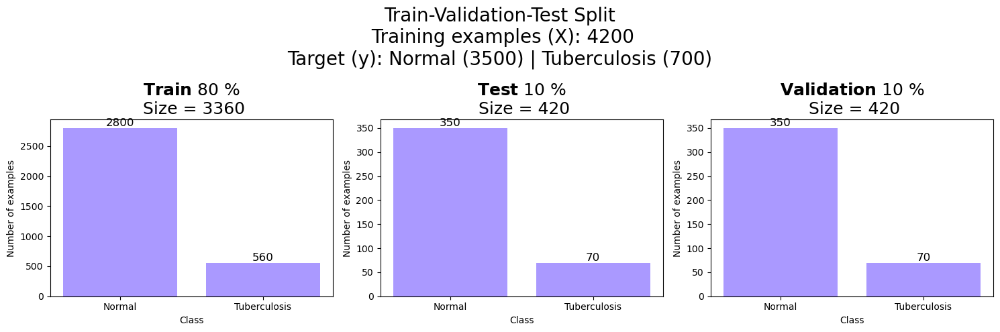

In [312]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_imbalanced, 
                        y=y_imbalanced, 
                        title='Train-Validation-Test Split', 
                        classe_labels=['Normal', 'Tuberculosis'], 
                        train_percent=0.8, 
                        val_percent=0.1, 
                        test_percent=0.1)

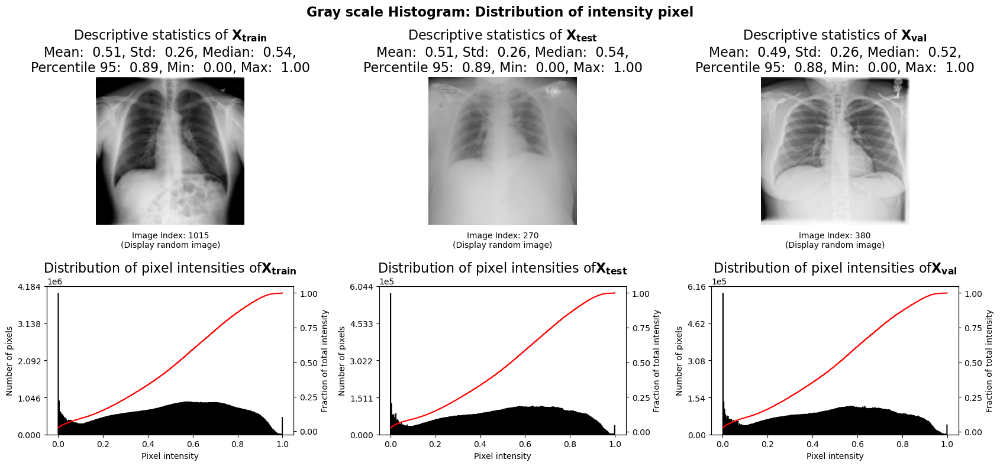

In [313]:
images = [X_train, X_test, X_val]
subsets = ['X_{train}', 'X_{test}', 'X_{val}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [314]:
# Remove unused variables to free up memory
del x_norm
del y_norm
del x_tb
del y_tb
del norm_tb_images
del abnorm_tb_images
del norm_tb_labels
del abnorm_tb_labels

del norm_norm_images
del abnorm_norm_images
del norm_norm_labels
del abnorm_norm_labels

del tb_cropped_images, tb_cropped_labels

del X_tb_augmented, y_tb_augmented

In [315]:
epochs = 10
batch_size = 64

In [316]:
cnn1 = CNN(unit_multiplier=0.05,
          input_shape=(128,128,3))
cnn1.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_42 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [317]:
history = cnn1.train(X_train, y_train, X_val, y_val,
                   epochs=epochs,
                   batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


In [318]:
def plot_history(history):
    # Accuracy 
    plt.plot(history.history['accuracy'], c = 'royalblue', linewidth = 2.5, label = 'Training')
    plt.plot(history.history['val_accuracy'], c = 'firebrick', linestyle = '--', label = 'Valid')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left', frameon = True, facecolor = 'white')
    plt.show()

    # Loss 
    plt.plot(history.history['loss'], c = 'royalblue', linewidth = 2.5, label = 'Training')
    plt.plot(history.history['val_loss'], c = 'firebrick', linestyle = '--', label = 'Valid')
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left',frameon = True, facecolor = 'white')
    plt.show()

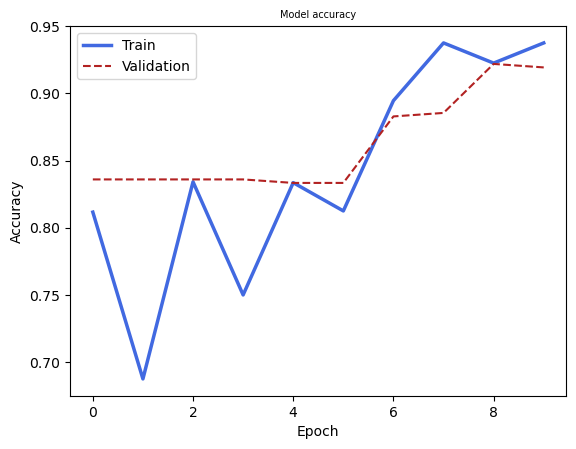

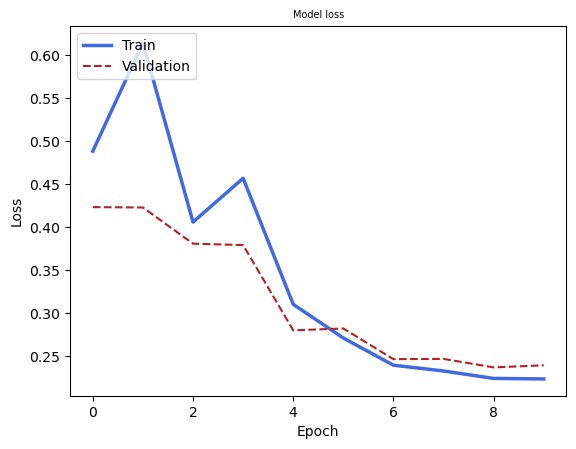

In [319]:
plot_history(history)

In [320]:
import json
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, accuracy_score, roc_curve, roc_auc_score, f1_score, auc

In [321]:
def evaluate(estimator, estimator_tag, experiment_tag, X_train, y_train, X_test, y_test, X_val, y_val):
    """
    Evaluate the performance of a model on different subsets of data.

    Args:
    - estimator: The trained model object
    - estimator_tag: Identifier for the model
    - experiment_tag: Identifier for the Experiment
    - X_train: Training data
    - y_train: Training labels
    - X_test: Test data
    - y_test: Test labels
    - X_val: Validation data
    - y_val: Validation labels

    Returns:
    - evaluation_results: DataFrame containing evaluation metrics
    """
    subsets = {'Train': (X_train, y_train), 'Test': (X_test, y_test), 'Validation': (X_val, y_val)}
    performances = []
    for subset_name, (X_subset, y_actual) in subsets.items():
        # Model Prediction/Y hat
        # y_pred_binary_predictions, y_probabilities
        
        y_pred, y_prob = estimator.predict_(X_subset)

        # Calculate ROC curve and AUC score
        fpr, tpr, thresholds = roc_curve(y_actual, y_prob)
        auc_score = auc(fpr, tpr)

        # Classification Report
        report = classification_report(y_actual, y_pred, output_dict=True)
        report_dict = json.loads(json.dumps(report))

        # Extract precision and recall from report_dict
        precision = report_dict['weighted avg']['precision']
        recall = report_dict['weighted avg']['recall']
        accuracy = report_dict['accuracy']
        f1_score = report_dict['weighted avg']['f1-score']

        # Confusion Matrix
        cm = confusion_matrix(y_actual, y_pred)
        TP = cm[0][0]
        FP = cm[0][1]
        FN = cm[1][0]
        TN = cm[1][1]
        
        sensitivity = TP / (TP + FN)  # Sensitivity or True Positive Rate
        specificity = TN / (TN + FP)  # Specificity or True Negative Rate

        performance = {
            'Model': estimator_tag,
            'Experiment_tag':experiment_tag,
            'Subset': subset_name,
            'FPR':fpr,
            'TPR':tpr,
            'TP': TP,
            'FP': FP,
            'FN': FN,
            'TN': TN,
            'Precision': precision,
            'Recall': recall,
            'Sensitivity': sensitivity,
            'Specificity': specificity,
            'F1 Score': f1_score,
            'AUC': auc_score,
            'Accuracy': accuracy,
        }

        performances.append(performance)

    return pd.DataFrame(performances)

In [322]:
evaluation_1 = evaluate(cnn1, 
                        'CNN_1_Baseline', 
                        'A',
                        X_train, 
                        y_train, 
                        X_test, 
                        y_test, 
                        X_val, 
                        y_val)

In [323]:
evaluation_1

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_1_Baseline,A,Train,"[0.0, 0.046785714285714285, 0.0467857142857142...","[0.0, 0.8214285714285714, 0.825, 0.825, 0.8267...",2664,136,97,463,0.932882,0.930655,0.964868,0.772955,0.931578,0.956534,0.930655
1,CNN_1_Baseline,A,Test,"[0.0, 0.002857142857142857, 0.0228571428571428...","[0.0, 0.0, 0.8, 0.8, 0.8142857142857143, 0.814...",339,11,14,56,0.939587,0.940476,0.960340,0.835821,0.939951,0.963592,0.940476
2,CNN_1_Baseline,A,Validation,"[0.0, 0.04, 0.05142857142857143, 0.05142857142...","[0.0, 0.7428571428571429, 0.7428571428571429, ...",335,15,18,52,0.920194,0.921429,0.949008,0.776119,0.920736,0.954531,0.921429


In [324]:
def plot_confusion_matrix(estimator,X,  y, subset_name):
    y_pred, y_prob = estimator.predict_(X)
    
    cm = confusion_matrix(y, y_pred)
    labels = ['Negative', 'Positive']

    # Extract TP, TN, FP, FN
    tn, fp, fn, tp = cm.ravel()
    sensitivity = tp / (tp + fn)  # Sensitivity or True Positive Rate
    specificity = tn / (tn + fp)  # Specificity or True Negative Rate

    plt.figure(figsize=(18, 9))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)



    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix - {subset_name}\n'
              f'True Positives: {tp} | True Negatives: {tn}\n'
              f'False Positives: {fp} (Type I error) | False Negatives: {fn} (Type II error)\n'
              f'Sensitivity (True Positive Rate): {sensitivity:.4f} | Specificity (True Negative Rate): {specificity:.4f}',
              loc='center', wrap=True)
    plt.show()

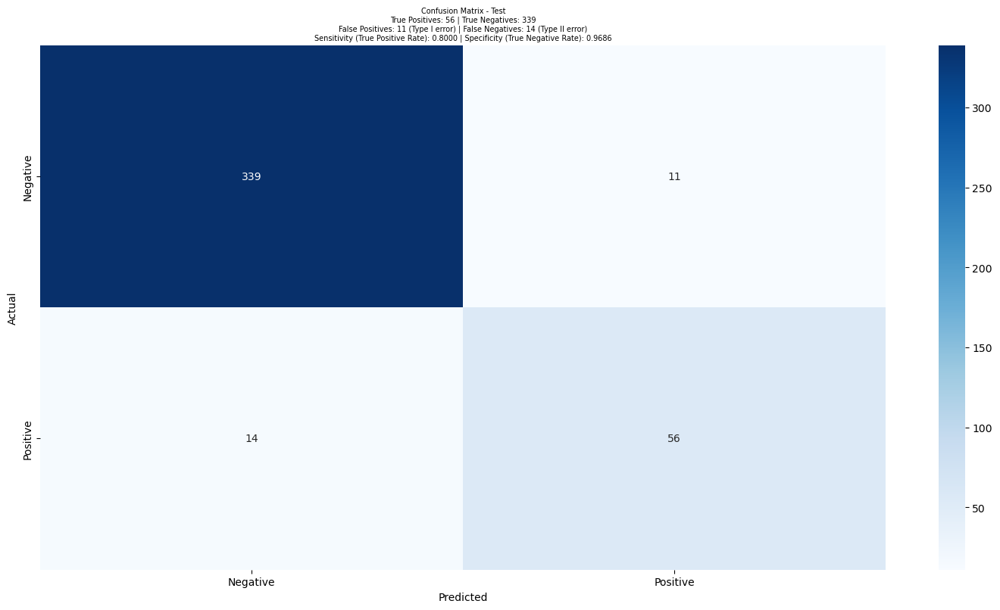

In [325]:
plot_confusion_matrix(estimator=cnn1,
                      X=X_test,  
                      y=y_test, 
                      subset_name='Test')

In [326]:
def plot_roc(estimator,X, y, subset_name):
    
    y_pred, y_prob = estimator.predict_(X)
    
    fpr, tpr, thresholds = roc_curve(y, y_prob)
    
    roc_auc = auc(fpr,tpr)

    # Print ROC Curve
    plt.figure(figsize=(18, 9))
    plt.plot(fpr, tpr, c = 'royalblue', linewidth = 2.5,label='AUC = %0.3f'% roc_auc)
    plt.plot([0,1],[0,1], c = 'firebrick', linestyle = '--')
    plt.xlim([-0.1,1.0])
    plt.ylim([-0.1,1.01])
    plt.xlabel('False positive rate (1-Specificity)')
    plt.ylabel('True positive rate (Sensitivity)')
    plt.title(f'ROC Curve - {subset_name}')
    plt.grid()
    plt.show()

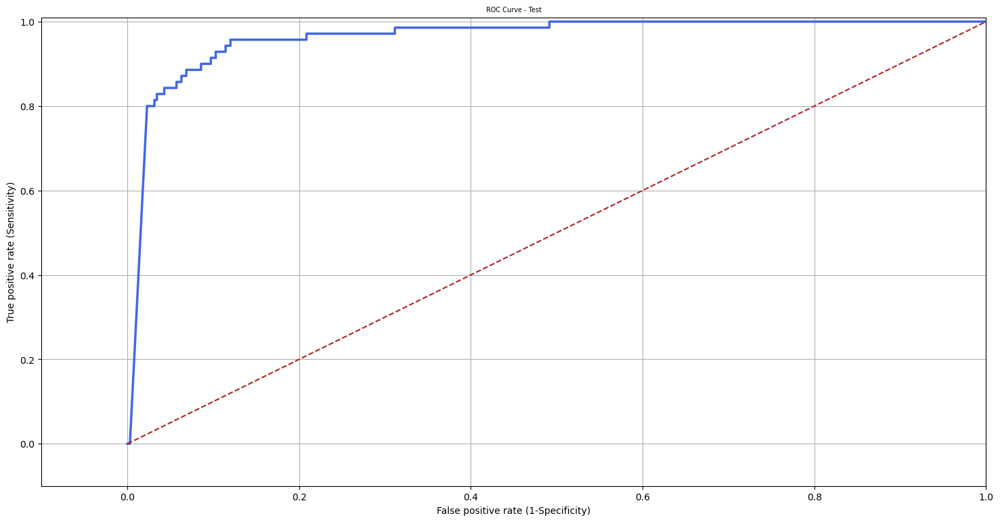

In [327]:
plot_roc(estimator=cnn1, 
         X=X_test, 
         y=y_test, 
         subset_name='Test')

In [328]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_over_sampling,
                                                                        y=y_over_sampling,
                                                                        title='Class Distribution in Train-Validation-Test Split (Over-Sampling)',
                                                                        classe_labels=['Normal', 'Tuberculosis'],
                                                                        train_percent=0.8,
                                                                        val_percent=0.1,
                                                                        test_percent=0.1,
                                                                        show_plot=False)

In [329]:
cnn2 = CNN(unit_multiplier=0.05,
           input_shape=(128,128,3))
cnn2.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_45 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [330]:
history2 = cnn2.train(X_train, y_train, X_val, y_val,
                        epochs=epochs,
                        batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


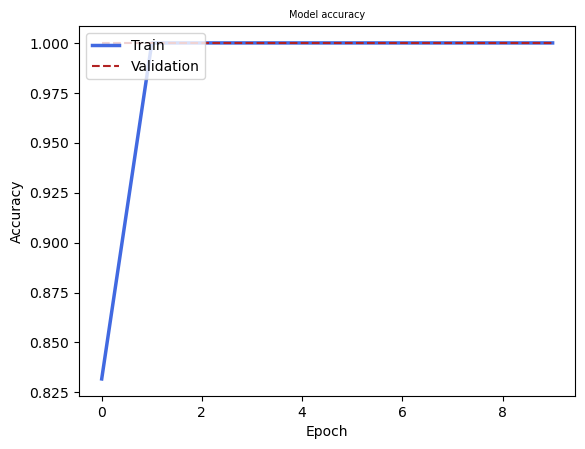

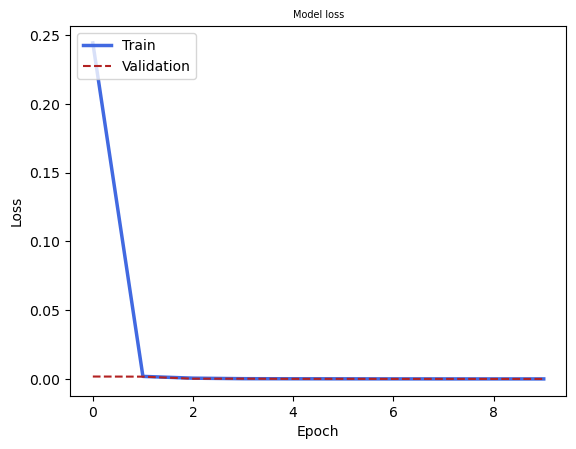

In [331]:
plot_history(history2)

In [332]:
evaluation_2 = evaluate(cnn2,
'CNN_2_Over_sampling',
'B',
X_train,
y_train,
X_test,
y_test,
X_val,
y_val)

In [333]:
evaluation_2

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_2_Over_sampling,B,Train,"[0.0, 0.0, 0.3342857142857143, 0.335, 0.338214...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",2800,0,0,2800,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1,CNN_2_Over_sampling,B,Test,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",350,0,0,350,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,CNN_2_Over_sampling,B,Validation,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",350,0,0,350,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [334]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_norm_undersampled,
y=y_norm_undersampled,
title='Class Distribution in Train-Validation-Test Split (Under-Samping)',
classe_labels=['Normal', 'Tuberculosis'],
train_percent=0.8,
val_percent=0.1,
test_percent=0.1,
                                                                        show_plot=False)

In [335]:
cnn3 = CNN(unit_multiplier=0.05,
input_shape=(128,128,3))
cnn3.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [336]:
history3 = cnn3.train(X_train, y_train, X_val, y_val,
epochs=epochs,
batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


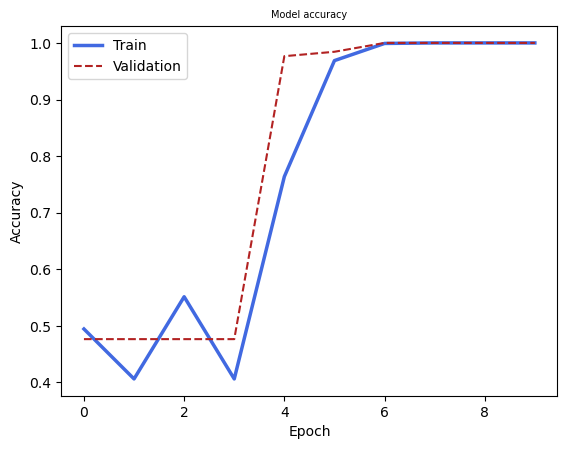

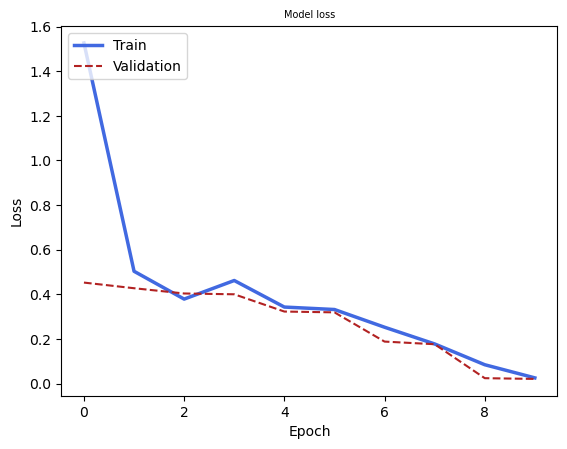

In [337]:
plot_history(history3)

In [338]:
evaluation_3 = evaluate(cnn3,
                        'CNN_3_Under_sampling',
                        'B',
                        X_train,
                        y_train,
                        X_test,
                        y_test,
                        X_val,
                        y_val)

In [339]:
evaluation_3

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_3_Under_sampling,B,Train,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0]","[0.0, 0.9535714285714286, 0.9607142857142857, ...",560,0,2,558,0.998221,0.998214,0.996441,1.0,0.998214,0.998214,0.998214
1,CNN_3_Under_sampling,B,Test,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.9285714285714286, 1.0, 1.0]",70,0,0,70,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,1.000000
2,CNN_3_Under_sampling,B,Validation,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.9571428571428572, 1.0, 1.0]",70,0,0,70,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,1.000000


/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


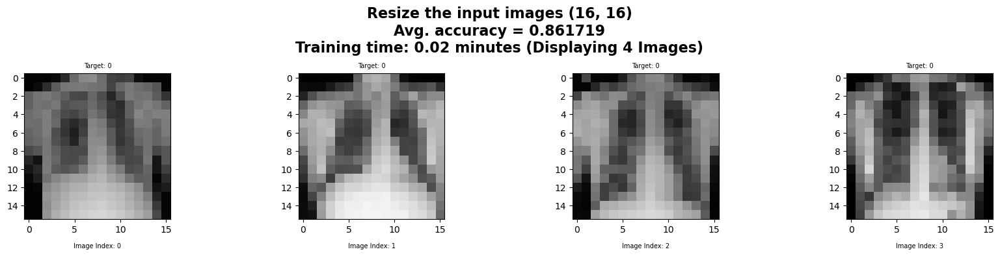

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


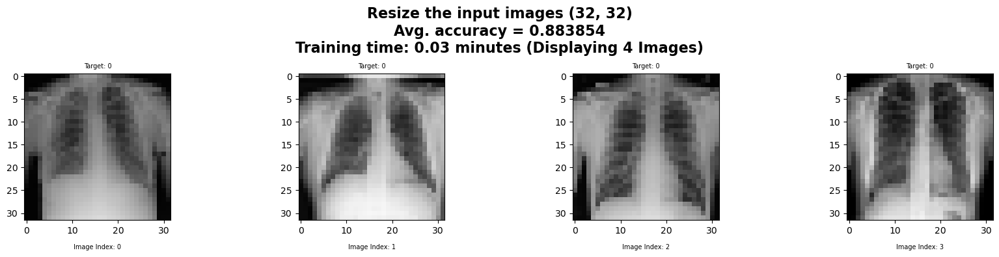

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


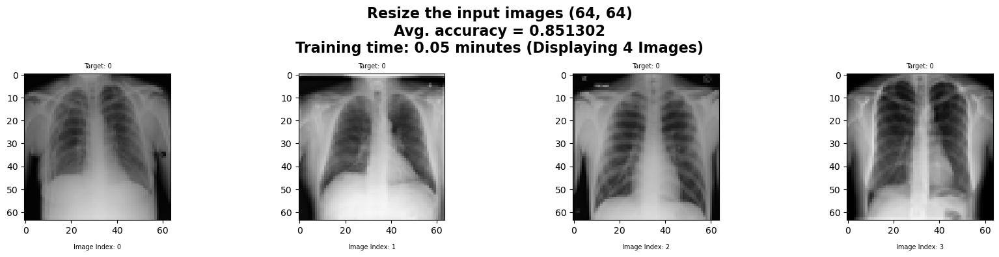

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


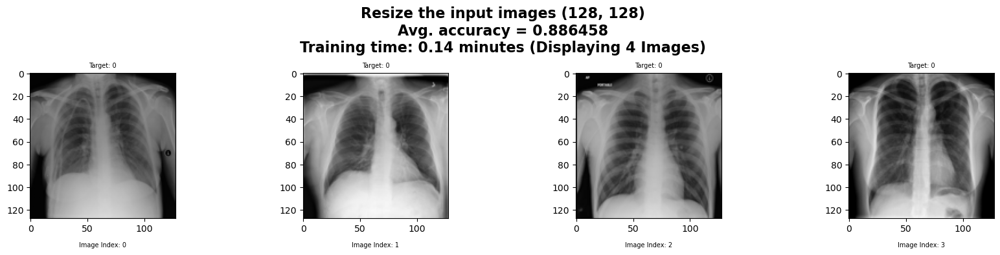

In [ ]:
image_size_performances = []
target_shapes = [(16, 16),(32, 32), (64, 64), (128, 128)]
for target_shape in target_shapes:
    # Input size
    input_shape = target_shape+ (3,) 
    # Resize the Input Images
    X_resized = tf.image.resize(X_imbalanced, target_shape).numpy()
    
    # Construct CNN Model
    cnn = CNN(unit_multiplier=0.05,
    input_shape=input_shape)
     
    # Split Train/Valid/Test subset
    X_train, X_temp, y_train, y_temp = train_test_split(
    X_resized, y_imbalanced, test_size=0.2, random_state=42, stratify=y_imbalanced)

    X_test, X_val, y_test, y_val = train_test_split(
        X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)
    
    # Train the model
    start_time = time.time()

    history = cnn.train(X_train, y_train, X_val, y_val,
                        epochs=epochs,
                        batch_size=batch_size)
    end_time = time.time()
    training_time = end_time - start_time
    # Evaluate to collect performance to compare other methods
    evaluation = evaluate(cnn,
                        f"CNN_{input_shape}",
                        'C',
                        X_train,
                        y_train,
                        X_test,
                        y_test,
                        X_val,
                        y_val)
    # Collect
    image_size_performances.append(evaluation)
    # Avg. Accuracy
    mean_acc = np.mean(history.history['val_accuracy'])
    # Display input resized images
    show_image(images=X_resized, target=y_imbalanced,
               title=f'Resize the input images {target_shape}\nAvg. accuracy = {mean_acc:2f}\nTraining time: {training_time/60:.2f} minutes', 
               num_display=4, 
               num_cols=4, 
               random_mode=False)

In [341]:
def numpy_convert_to_grayscale(X):
    converted_images = []
    for image in X:
        # Convert image data type to uint8
        image_uint8 = (image * 255).astype(np.uint8)
        # Convert RGB image to grayscale
        gray = cv2.cvtColor(image_uint8, cv2.COLOR_RGB2GRAY)
        gray = np.expand_dims(gray, axis=-1)
        converted_images.append(gray)
    return np.array(converted_images)

In [342]:
X_imbalanced_gray = numpy_convert_to_grayscale(X_imbalanced)

In [343]:
X_imbalanced_gray.shape

(4200, 128, 128, 1)

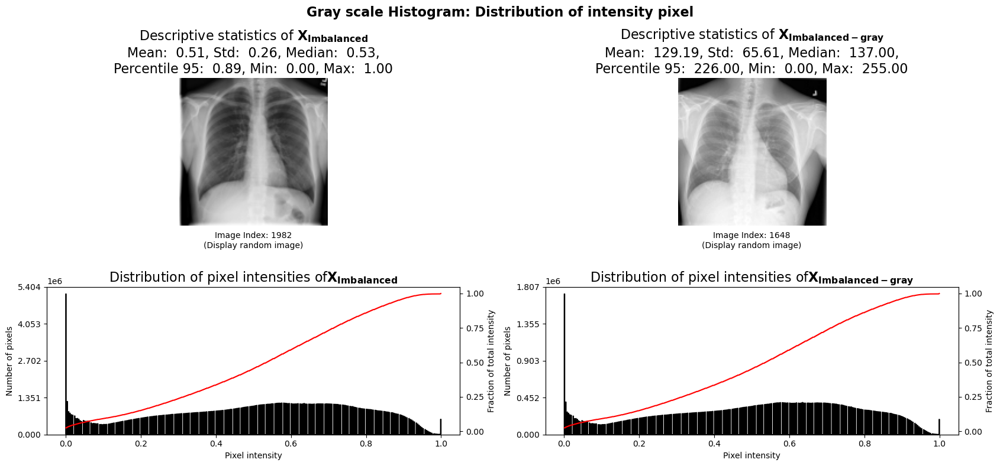

In [344]:
images = [X_imbalanced, X_imbalanced_gray]
subsets = ['X_{Imbalanced}', 'X_{Imbalanced-gray}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [345]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_imbalanced_gray,
    y=y_imbalanced,
    title='Class Distribution in Train-Validation-Test Split (Gray Scale)',
    classe_labels=['Normal', 'Tuberculosis'],
    train_percent=0.8,
    val_percent=0.1,
    test_percent=0.1,
    show_plot=False)

In [346]:
cnn4 = CNN(unit_multiplier=0.05,
           input_shape=(128,128,1))
cnn4.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_63 (Conv2D)              │ (None, 128, 128, 1)    │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_64 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,437 (36.86 KB)

 Trainable params: 9,437 (36.86 KB)

 Non-trainable params: 0 (0.00 B)

In [347]:
history4 = cnn4.train(X_train, 
                      y_train, 
                      X_val, 
                      y_val,
                      epochs=epochs,
                    batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


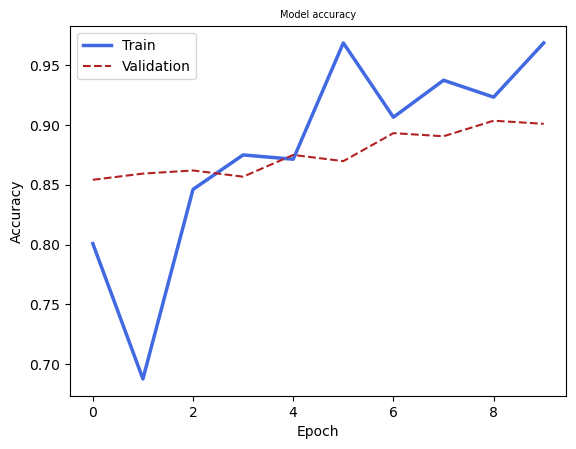

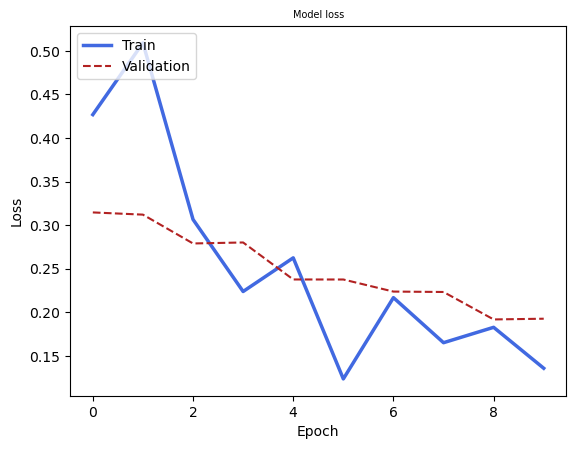

In [348]:
plot_history(history4)

In [349]:
evaluation_4 = evaluate(cnn4,
                        'CNN_4_Gray_Scale',
                        'D',
                        X_train,
                        y_train,
                        X_test,
                        y_test,
                        X_val,
                        y_val)

In [350]:
evaluation_4

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_4_Gray_Scale,D,Train,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.000357142857142857...","[0.0, 0.0017857142857142857, 0.025, 0.02857142...",2732,68,141,419,0.935830,0.937798,0.950922,0.860370,0.936029,0.975311,0.937798
1,CNN_4_Gray_Scale,D,Test,"[0.0, 0.002857142857142857, 0.0028571428571428...","[0.0, 0.0, 0.12857142857142856, 0.128571428571...",336,14,29,41,0.891366,0.897619,0.920548,0.745455,0.892550,0.926245,0.897619
2,CNN_4_Gray_Scale,D,Validation,"[0.0, 0.0, 0.0, 0.002857142857142857, 0.002857...","[0.0, 0.014285714285714285, 0.0857142857142857...",337,13,29,41,0.893847,0.900000,0.920765,0.759259,0.894666,0.955571,0.900000


In [351]:
del X_imbalanced_gray

#### Contrast Stretching

In [352]:
X_stretched = contrast_stretching(X_imbalanced)

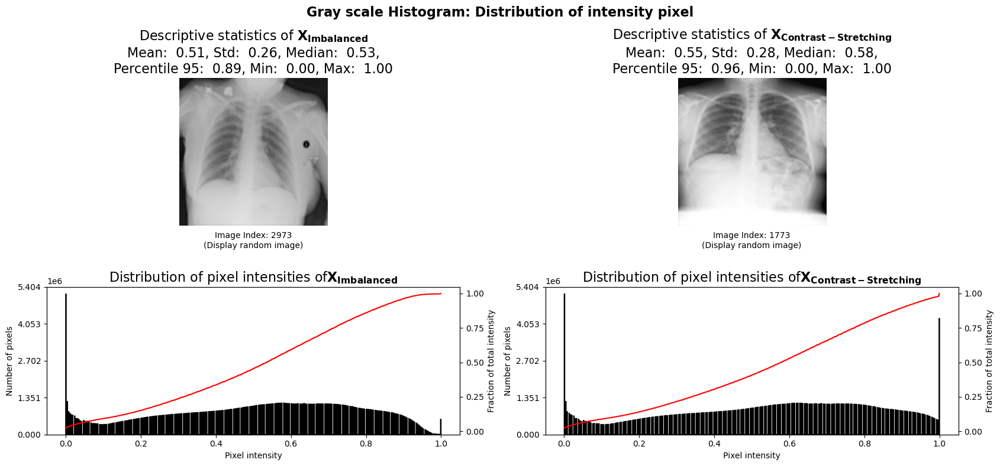

In [353]:
images = [X_imbalanced, X_stretched]
subsets = ['X_{Imbalanced}', 'X_{Contrast-Stretching}']
# For visualization
plot_gray_scale_histogram(images=images, 
                          titles=subsets, 
                          bins=555)

In [354]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_stretched,
    y=y_imbalanced,
    title='Class Distribution in Train-Validation-Test Split (X_stretched)',
    classe_labels=['Normal', 'Tuberculosis'],
    train_percent=0.8,
    val_percent=0.1,
    test_percent=0.1,
                                                                        show_plot=False)

In [355]:
cnn5 = CNN(unit_multiplier=0.05,
        input_shape=(128,128,3))
cnn5.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_66 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_68 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [356]:
history5 = cnn5.train(X_train, y_train, X_val, y_val,
                        epochs=epochs,
                        batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


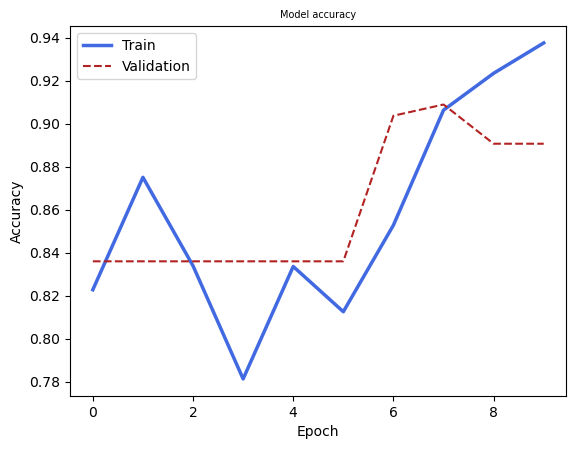

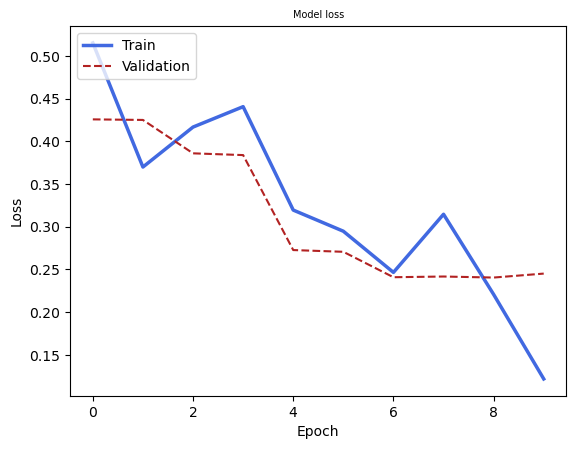

In [357]:
plot_history(history5)

In [358]:
evaluation_5 = evaluate(cnn5,
                    'CNN_5_Contrast-Stretching',
                    'E',
                    X_train,
                    y_train,
                    X_test,
                    y_test,
                    X_val,
                    y_val)

In [359]:
evaluation_5

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_5_Contrast-Stretching,E,Train,"[0.0, 0.0032142857142857142, 0.003214285714285...","[0.0, 0.4625, 0.4660714285714286, 0.4660714285...",2790,10,299,261,0.913187,0.908036,0.903205,0.963100,0.894301,0.971847,0.908036
1,CNN_5_Contrast-Stretching,E,Test,"[0.0, 0.002857142857142857, 0.0028571428571428...","[0.0, 0.37142857142857144, 0.42857142857142855...",349,1,44,26,0.900528,0.892857,0.888041,0.962963,0.872209,0.971143,0.892857
2,CNN_5_Contrast-Stretching,E,Validation,"[0.0, 0.011428571428571429, 0.0114285714285714...","[0.0, 0.38571428571428573, 0.4142857142857143,...",346,4,41,29,0.891512,0.892857,0.894057,0.878788,0.876303,0.962816,0.892857


In [360]:
# Remove variable for memory constraint
del X_stretched

#### Histogram Equalization

In [361]:
X_eq = equalization(X_imbalanced)

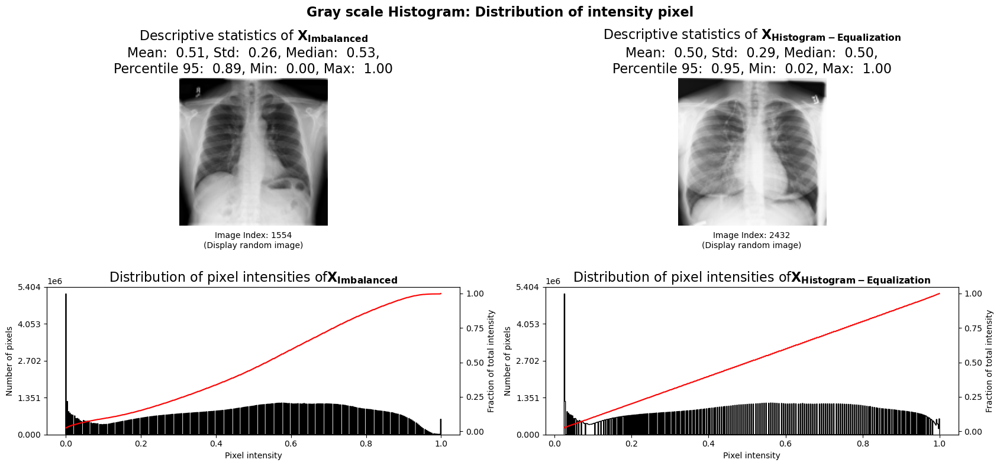

In [362]:

images = [X_imbalanced, X_eq]
subsets = ['X_{Imbalanced}', 'X_{Histogram-Equalization}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [363]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_eq,
    y=y_imbalanced,
    title='Class Distribution in Train-Validation-Test Split (Histogram-Equalization)',
    classe_labels=['Normal', 'Tuberculosis'],
    train_percent=0.8,
    val_percent=0.1,
    test_percent=0.1,show_plot=False)

In [364]:
cnn6 = CNN(unit_multiplier=0.05,
input_shape=(128,128,3))
cnn6.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_69 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [365]:
history6 = cnn6.train(X_train, y_train, X_val, y_val,
epochs=epochs,
batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


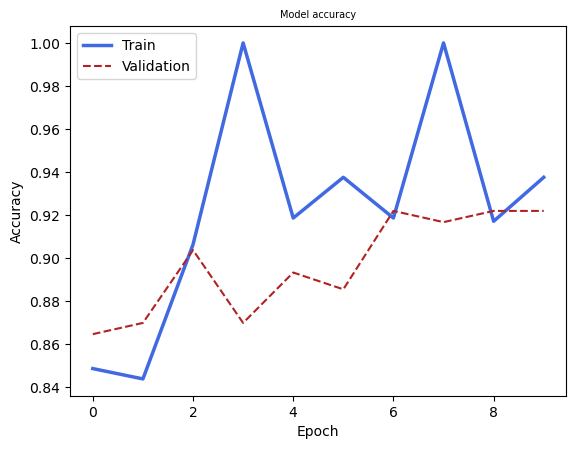

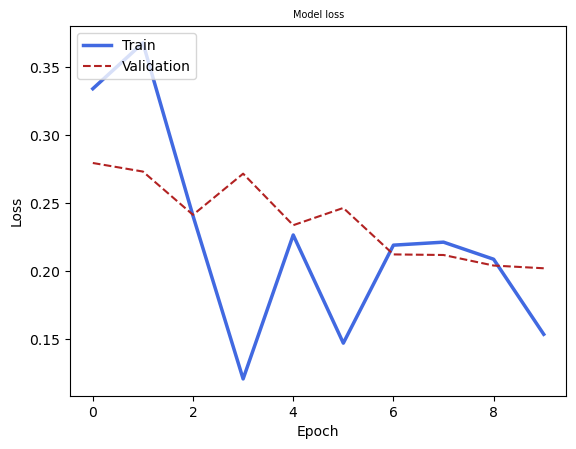

In [366]:
plot_history(history6)

In [367]:
evaluation_6 = evaluate(cnn6,
                    'CNN_6_Histogram-Equalization',
                        'E',
                    X_train,
                    y_train,
                    X_test,
                    y_test,
                    X_val,
                    y_val)

In [368]:
evaluation_6

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_6_Histogram-Equalization,E,Train,"[0.0, 0.012857142857142857, 0.0128571428571428...","[0.0, 0.6928571428571428, 0.7, 0.7, 0.70535714...",2742,58,123,437,0.944695,0.946131,0.957068,0.882828,0.944781,0.974892,0.946131
1,CNN_6_Histogram-Equalization,E,Test,"[0.0, 0.011428571428571429, 0.0114285714285714...","[0.0, 0.6428571428571429, 0.6714285714285714, ...",344,6,22,48,0.931390,0.933333,0.939891,0.888889,0.929777,0.972367,0.933333
2,CNN_6_Histogram-Equalization,E,Validation,"[0.0, 0.014285714285714285, 0.02, 0.02, 0.0228...","[0.0, 0.6142857142857143, 0.6142857142857143, ...",342,8,25,45,0.918076,0.921429,0.931880,0.849057,0.916930,0.969898,0.921429


In [369]:
# Remove variable for memory constraint
del X_eq

In [370]:
X_adapteq = adaptive_equalization(X_imbalanced, 0.01, 16)

processing...: 100%|██████████| 263/263 [00:40<00:00,  6.47it/s]


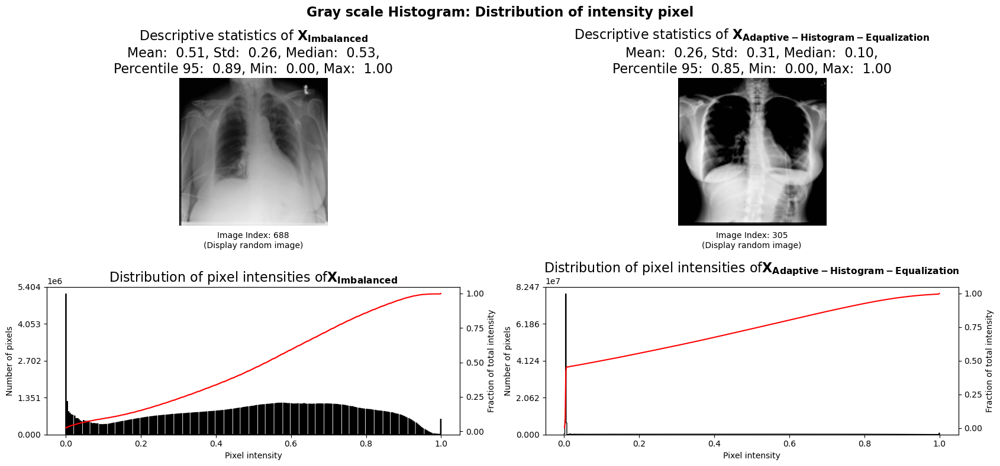

In [371]:
images = [X_imbalanced, X_adapteq]
subsets = ['X_{Imbalanced}', 'X_{Adaptive-Histogram-Equalization}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [372]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_adapteq,
    y=y_imbalanced,
    title='Class Distribution in Train-Validation-Test Split (Adaptive-Histogram-Equalization)',
    classe_labels=['Normal', 'Tuberculosis'],
    train_percent=0.8,
    val_percent=0.1,
    test_percent=0.1,
                                                                        show_plot=False)

In [373]:
cnn7 = CNN(unit_multiplier=0.05,
input_shape=(128,128,3))
cnn7.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 128, 128, 1)    │            28 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 64, 64, 3)      │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 32, 32, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 32, 32, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 16, 16, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 6)              │         9,222 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 1)              │             7 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,455 (36.93 KB)

 Trainable params: 9,455 (36.93 KB)

 Non-trainable params: 0 (0.00 B)

In [374]:
history7 = cnn7.train(X_train, 
                      y_train, 
                      X_val, 
                      y_val,
                    epochs=epochs,
                    batch_size=batch_size)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


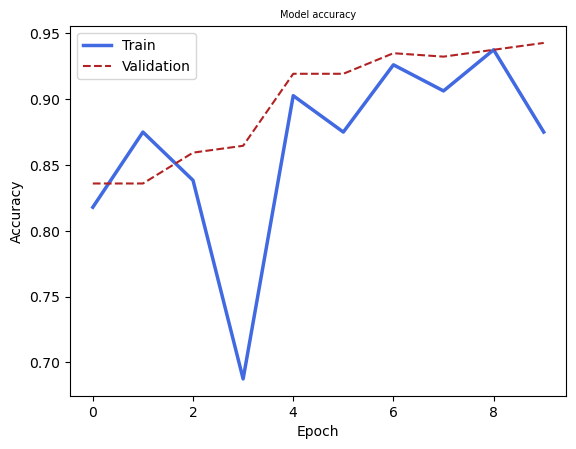

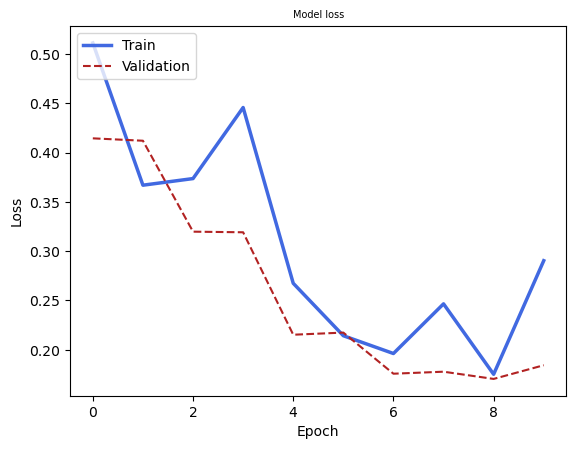

In [375]:
plot_history(history7)

In [376]:
evaluation_7 = evaluate(cnn7,
                    'CNN_7_Adaptive_Histogram_Equalization',
                        'E',
                    X_train,
                    y_train,
                    X_test,
                    y_test,
                    X_val,
                    y_val)

In [377]:
evaluation_7

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_7_Adaptive_Histogram_Equalization,E,Train,"[0.0, 0.0, 0.0, 0.00035714285714285714, 0.0003...","[0.0, 0.0017857142857142857, 0.371428571428571...",2733,67,111,449,0.945835,0.947024,0.960970,0.870155,0.946147,0.960130,0.947024
1,CNN_7_Adaptive_Histogram_Equalization,E,Test,"[0.0, 0.0, 0.0, 0.002857142857142857, 0.002857...","[0.0, 0.014285714285714285, 0.4857142857142857...",341,9,20,50,0.928408,0.930952,0.944598,0.847458,0.928543,0.939918,0.930952
2,CNN_7_Adaptive_Histogram_Equalization,E,Validation,"[0.0, 0.0, 0.0, 0.002857142857142857, 0.002857...","[0.0, 0.014285714285714285, 0.5857142857142857...",343,7,15,55,0.946267,0.947619,0.958101,0.887097,0.946328,0.971306,0.947619



### 4.1.6. Model Benchmark/Model Comparison:
Different models are benchmarked and compared to determine which one model have the best performance for tuberculosis prediction.

In [378]:
performances = pd.concat([evaluation_1, evaluation_2, evaluation_3, evaluation_4, evaluation_5, evaluation_6, evaluation_7]+ image_size_performances, ignore_index=True)
performances

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_1_Baseline,A,Train,"[0.0, 0.046785714285714285, 0.0467857142857142...","[0.0, 0.8214285714285714, 0.825, 0.825, 0.8267...",2664,136,97,463,0.932882,0.930655,0.964868,0.772955,0.931578,0.956534,0.930655
1,CNN_1_Baseline,A,Test,"[0.0, 0.002857142857142857, 0.0228571428571428...","[0.0, 0.0, 0.8, 0.8, 0.8142857142857143, 0.814...",339,11,14,56,0.939587,0.940476,0.960340,0.835821,0.939951,0.963592,0.940476
2,CNN_1_Baseline,A,Validation,"[0.0, 0.04, 0.05142857142857143, 0.05142857142...","[0.0, 0.7428571428571429, 0.7428571428571429, ...",335,15,18,52,0.920194,0.921429,0.949008,0.776119,0.920736,0.954531,0.921429
3,CNN_2_Over_sampling,B,Train,"[0.0, 0.0, 0.3342857142857143, 0.335, 0.338214...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",2800,0,0,2800,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,CNN_2_Over_sampling,B,Test,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",350,0,0,350,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,CNN_2_Over_sampling,B,Validation,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",350,0,0,350,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,CNN_3_Under_sampling,B,Train,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0]","[0.0, 0.9535714285714286, 0.9607142857142857, ...",560,0,2,558,0.998221,0.998214,0.996441,1.000000,0.998214,0.998214,0.998214
7,CNN_3_Under_sampling,B,Test,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.9285714285714286, 1.0, 1.0]",70,0,0,70,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,CNN_3_Under_sampling,B,Validation,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.9571428571428572, 1.0, 1.0]",70,0,0,70,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
9,CNN_4_Gray_Scale,D,Train,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.000357142857142857...","[0.0, 0.0017857142857142857, 0.025, 0.02857142...",2732,68,141,419,0.935830,0.937798,0.950922,0.860370,0.936029,0.975311,0.937798


In [379]:
cmap = 'RdYlGn'  # Red-Yellow-Green gradient
included_cols = ['Model', 'Subset', 'TP', 'FP', 'FN', 'TN', 'Precision',
       'Recall', 'Sensitivity', 'Specificity', 'F1 Score', 'AUC', 'Accuracy']

In [380]:
performances.loc[performances['Experiment_tag']== 'A'][included_cols].style.background_gradient(cmap=cmap, subset=['F1 Score', 'Accuracy'])

,Model,Subset,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_1_Baseline,Train,2664,136,97,463,0.932882,0.930655,0.964868,0.772955,0.931578,0.956534,0.930655
1,CNN_1_Baseline,Test,339,11,14,56,0.939587,0.940476,0.960340,0.835821,0.939951,0.963592,0.940476
2,CNN_1_Baseline,Validation,335,15,18,52,0.920194,0.921429,0.949008,0.776119,0.920736,0.954531,0.921429


In [381]:
performances.loc[performances['Experiment_tag']== 'B'][included_cols].style.background_gradient(cmap=cmap, subset=['F1 Score'])

,Model,Subset,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
3,CNN_2_Over_sampling,Train,2800,0,0,2800,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,CNN_2_Over_sampling,Test,350,0,0,350,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,CNN_2_Over_sampling,Validation,350,0,0,350,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,CNN_3_Under_sampling,Train,560,0,2,558,0.998221,0.998214,0.996441,1.000000,0.998214,0.998214,0.998214
7,CNN_3_Under_sampling,Test,70,0,0,70,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,CNN_3_Under_sampling,Validation,70,0,0,70,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [382]:
performances.loc[performances['Experiment_tag']== 'C'][included_cols].style.background_gradient(cmap=cmap, subset=['Accuracy'])

,Model,Subset,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
21,"CNN_(16, 16, 3)",Train,2745,55,282,278,0.894838,0.899702,0.906838,0.834835,0.888908,0.917942,0.899702
22,"CNN_(16, 16, 3)",Test,346,4,37,33,0.901477,0.902381,0.903394,0.891892,0.889525,0.916408,0.902381
23,"CNN_(16, 16, 3)",Validation,348,2,34,36,0.917057,0.914286,0.910995,0.947368,0.903461,0.937102,0.914286
24,"CNN_(32, 32, 3)",Train,2743,57,156,404,0.934550,0.936607,0.946188,0.876356,0.934084,0.967178,0.936607
25,"CNN_(32, 32, 3)",Test,339,11,29,41,0.899073,0.904762,0.921196,0.788462,0.898930,0.942735,0.904762
26,"CNN_(32, 32, 3)",Validation,345,5,21,49,0.936754,0.938095,0.942623,0.907407,0.934793,0.962980,0.938095
27,"CNN_(64, 64, 3)",Train,2736,64,285,275,0.889919,0.896131,0.905660,0.811209,0.885336,0.914619,0.896131
28,"CNN_(64, 64, 3)",Test,334,16,40,30,0.852902,0.866667,0.893048,0.652174,0.855084,0.894898,0.866667
29,"CNN_(64, 64, 3)",Validation,335,15,42,28,0.849022,0.864286,0.888594,0.651163,0.850592,0.883633,0.864286
30,"CNN_(128, 128, 3)",Train,2795,5,214,346,0.938359,0.934821,0.928880,0.985755,0.928517,0.982727,0.934821


In [383]:
# RGB
performances.loc[performances['Experiment_tag']== 'A'][included_cols].style.background_gradient(cmap=cmap, subset=['Accuracy'])

,Model,Subset,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_1_Baseline,Train,2664,136,97,463,0.932882,0.930655,0.964868,0.772955,0.931578,0.956534,0.930655
1,CNN_1_Baseline,Test,339,11,14,56,0.939587,0.940476,0.960340,0.835821,0.939951,0.963592,0.940476
2,CNN_1_Baseline,Validation,335,15,18,52,0.920194,0.921429,0.949008,0.776119,0.920736,0.954531,0.921429


In [384]:
# Grayscale
performances.loc[performances['Experiment_tag']== 'D'][included_cols].style.background_gradient(cmap=cmap, subset=['Accuracy'])

,Model,Subset,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
9,CNN_4_Gray_Scale,Train,2732,68,141,419,0.935830,0.937798,0.950922,0.860370,0.936029,0.975311,0.937798
10,CNN_4_Gray_Scale,Test,336,14,29,41,0.891366,0.897619,0.920548,0.745455,0.892550,0.926245,0.897619
11,CNN_4_Gray_Scale,Validation,337,13,29,41,0.893847,0.900000,0.920765,0.759259,0.894666,0.955571,0.900000


In [385]:
X_over_sampling_eq = equalization(X_over_sampling)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [7.43634033203125..255.0].


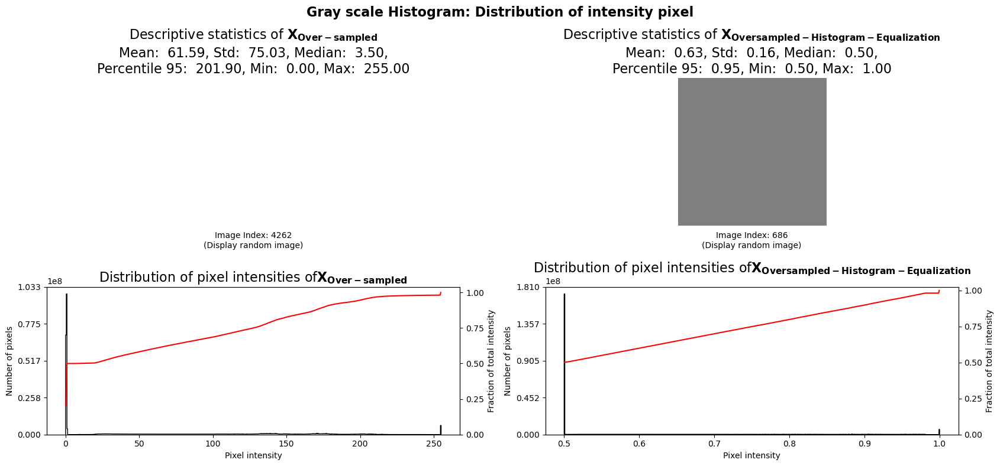

In [386]:
images = [X_over_sampling, X_over_sampling_eq]
subsets = ['X_{Over-sampled}', 'X_{Oversampled-Histogram-Equalization}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [387]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X_over_sampling_eq,
                                                                        y=y_over_sampling,
                                                                        title='Class Distribution in Train-Validation-Test Split (Oversampled-With-Histogram-Equalization)',
                                                                        classe_labels=['Normal', 'Tuberculosis'],
                                                                        train_percent=0.8,
                                                                        val_percent=0.1,
                                                                        test_percent=0.1,
                                                                        show_plot=False)

In [388]:
cnn_ba = CNN(unit_multiplier=0.1,
             input_shape=(128,128,3),
             verbose=1)
cnn_ba.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_75 (Conv2D)              │ (None, 128, 128, 3)    │            84 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_76 (Conv2D)              │ (None, 64, 64, 6)      │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 32, 32, 12)     │           660 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 16, 16, 12)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 3072)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 12)             │        36,876 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 12)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 1)              │            13 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,801 (147.66 KB)

 Trainable params: 37,801 (147.66 KB)

 Non-trainable params: 0 (0.00 B)

In [389]:
history_ba = cnn_ba.train(X_train, 
                          y_train, 
                          X_val, 
                          y_val,
                          epochs=30,
                          batch_size=32)

Epoch 1/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - accuracy: 0.7828 - loss: 0.4434 - val_accuracy: 1.0000 - val_loss: 0.3016
Epoch 2/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step - accuracy: 1.0000 - loss: 0.2929 - val_accuracy: 1.0000 - val_loss: 0.2655
Epoch 3/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 1.0000 - loss: 0.2585 - val_accuracy: 1.0000 - val_loss: 0.2346
Epoch 4/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step - accuracy: 1.0000 - loss: 0.2342 - val_accuracy: 1.0000 - val_loss: 0.2078
Epoch 5/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 1.0000 - loss: 0.2011 - val_accuracy: 1.0000 - val_loss: 0.1847
Epoch 6/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 1.0000 - loss: 0.1831 - val_accuracy: 1.0000 - val_loss: 0.1645
Epoch 7/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 1.0000 - loss: 0.1596 - val_accuracy: 1.0000 - val_loss: 0.1469
Epoch 8/30
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 1.0000 - loss: 0.1435 - val_accu

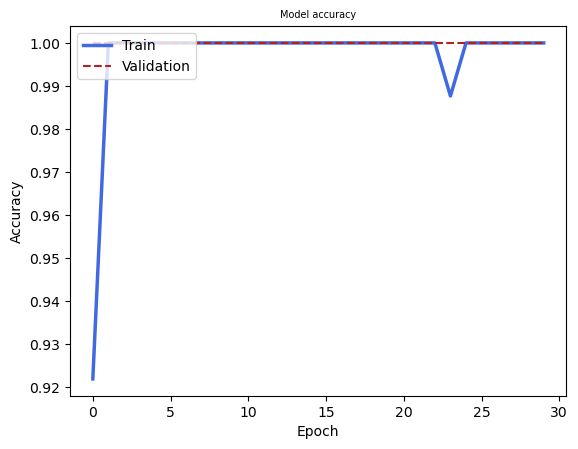

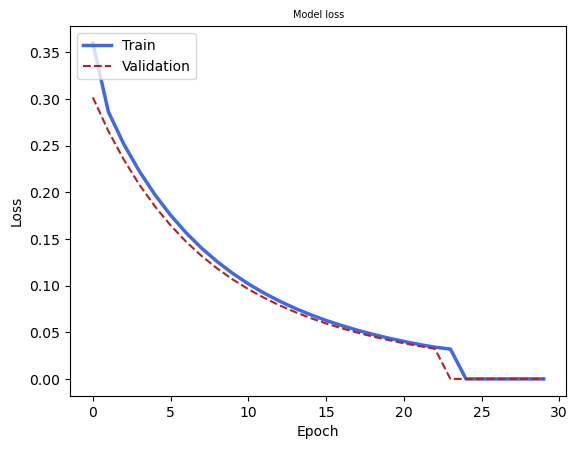

In [390]:
plot_history(history_ba)

In [391]:
evaluation_ba = evaluate(cnn_ba,
                    'CNN_best_artifact',
                         'L',
                    X_train,
                    y_train,
                    X_test,
                    y_test,
                    X_val,
                    y_val)

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [392]:
evaluation_ba

,Model,Experiment_tag,Subset,FPR,TPR,TP,FP,FN,TN,Precision,Recall,Sensitivity,Specificity,F1 Score,AUC,Accuracy
0,CNN_best_artifact,L,Train,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.895, 0.9389285714285714, 0.96964285714...",2800,0,0,2800,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1,CNN_best_artifact,L,Test,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.8771428571428571, 0.94, 0.965714285714...",350,0,0,350,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,CNN_best_artifact,L,Validation,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.00857142...","[0.0, 0.9085714285714286, 0.9457142857142857, ...",350,0,0,350,1.0,1.0,1.0,1.0,1.0,1.0,1.0


22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


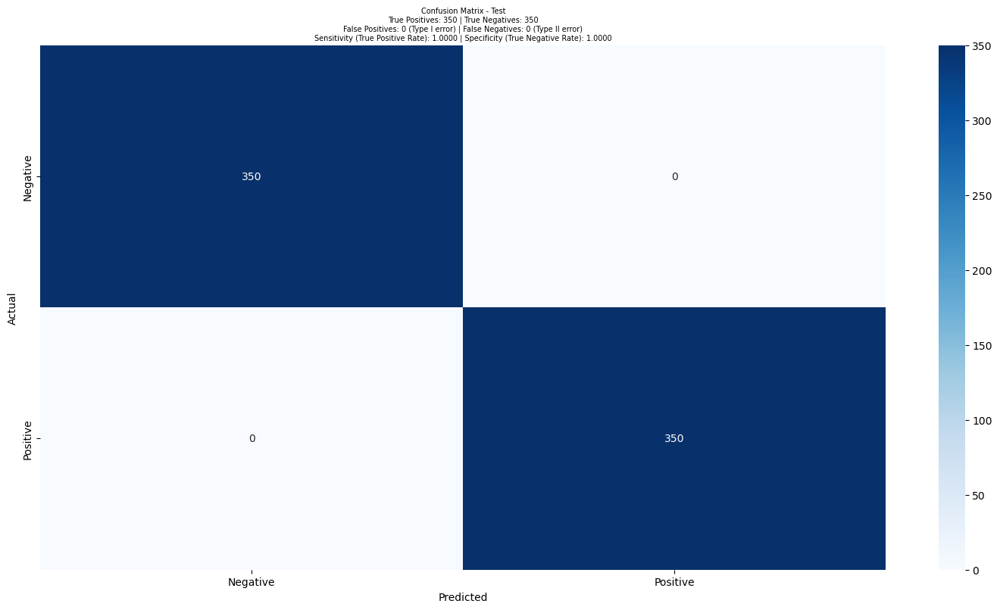

In [393]:
plot_confusion_matrix(estimator=cnn_ba,
                      X=X_test,  
                      y=y_test, 
                      subset_name='Test')

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


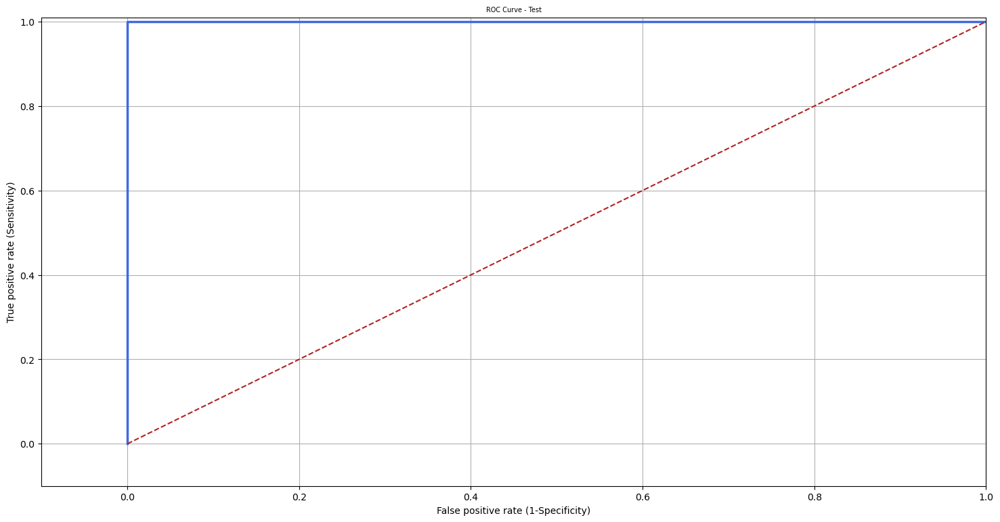

In [394]:
plot_roc(estimator=cnn_ba, 
         X=X_test, 
         y=y_test, 
         subset_name='Test')

In [395]:
# cv_scores = cnn_ba.cv(X=X_over_sampling_eq, y=y_over_sampling, cv=5)

In [396]:
# plt.figure(figsize=(10, 6))
# bars = plt.bar(range(1, len(cv_scores) + 1), cv_scores)
# plt.title('Cross-Validation Scores')
# plt.xlabel('Fold')
# plt.ylabel('Validation Score')
# plt.grid(axis='y')  # Display gridlines only along the y-axis

# # Add text annotations to each bar
# for bar in bars:
#     height = bar.get_height()
#     plt.text(bar.get_x() + bar.get_width() / 2, height, round(height, 2),
#              ha='center', va='bottom')

# plt.show()

In [402]:
def compare_actual_and_predicted_xray(estimator, images, target, title, num_display=16, num_cols=4, random_mode=False):
    '''
    Compare Actual X-ray Images with Model Predictions.

    Parameters:
        estimator: Model used for predictions.
        images (ndarray): Input data as a numpy array.
        target (ndarray): Target data as a numpy array.
        title (str): Title of the plot.
        num_display (int, optional): Number of images to display. Default is 16.
        num_cols (int, optional): Number of columns in the plot. Default is 4.
        random_mode (bool, optional): If True, display images randomly. If False, display the first num_display images. Default is False.

    Returns:
        None

    This function generates a visual comparison between actual X-ray images and their corresponding model predictions. It displays a grid of images with labels to show whether the model's predictions match the actual target values. The grid is organized in rows and columns based on the specified parameters.

    The function does not return any values; it displays the comparison plot directly.
    '''

    n_cols = min(num_cols, num_display)
    n_rows = int(np.ceil(num_display / n_cols))

    title = r'$\bf{' + "Actual-Image" + '}$' + " vs " + \
        r'$\bf{' + "Model-Prediction" + '}$'
    y_pred, y_prob = estimator.predict_(images)

    n_images = min(num_display, len(images))
    if random_mode:
        random_indices = np.random.choice(
            len(images), num_display, replace=False)
    else:
        random_indices = np.arange(num_display)

    fig, axes = plt.subplots(
        nrows=n_rows, ncols=n_cols, figsize=(20, 4*n_rows))
    for i, ax in enumerate(axes.flatten()):
        if i >= n_images:  # Check if the index exceeds the available number of images
            break
        # Incase (Did PCA)
        index = random_indices[i]
        if len(images.shape) == 2:
            image = images[index].reshape((128, 128)).astype(int)
        else:
            image = images[index]
        actual_label = int(target[index])
        model_pred_label = int(y_pred[index])
        model_prob = '{:.3f}'.format(float(y_prob[index]))
        ax.imshow(
            image, cmap='gray' if actual_label == model_pred_label else 'OrRd')
        ax.set_title(
            f"Actual: {actual_label},\nModel Prediction: {model_pred_label}\nProbability: {model_prob}")
    plt.suptitle(f"{title} (Displaying {num_display} Images)",
                 fontsize=16, fontweight='bold')

    fig.set_facecolor('white')
    plt.tight_layout()  
    plt.show()

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/1961626843.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  model_pred_label = int(y_pred[index])
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/1961626843.py:49: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  model_prob = '{:.3f}'.format(float(y_prob[index]))


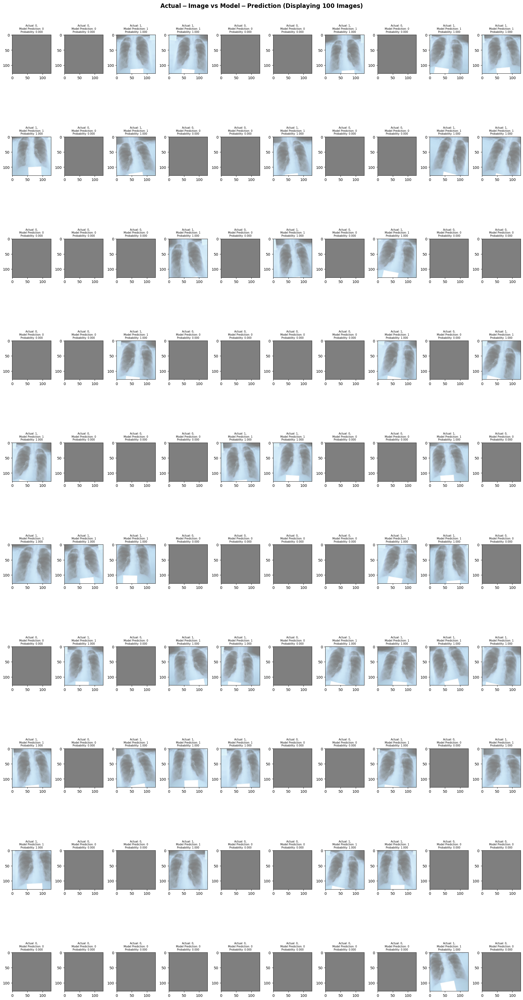

In [403]:
compare_actual_and_predicted_xray(
                estimator=cnn_ba,
                images=X_test,
                target=y_test, 
                title=None,
                num_display=100,
                num_cols=10, 
                random_mode=True)

In [404]:
import cv2 as cv

from skimage.filters import threshold_otsu
from skimage.color import label2rgb
from skimage.morphology import closing, square
from skimage.measure import label, regionprops
from skimage.segmentation import clear_border

import matplotlib.patches as mpatches

In [405]:
class ImageSegmentation:
    def __init__(self, input_shape, clip_limit=0.01, sqr_value=1):
        self.input_shape = input_shape
        self.clip_limit = clip_limit
        self.sqr_value = sqr_value

        
    def segmentize(self, X, return_only_overlay=True):
        X = X[:, :, 0]
        # 5.1 Equalize the image with CLAHE
        X = exposure.equalize_adapthist(
            X, clip_limit=self.clip_limit, nbins=256)

        # 5.2 Create a binary threshold mask and apply it to the image
        thresh = threshold_otsu(image=X, nbins=256, hist=None)
        # Invert Binary Image       
        thresh = X > thresh
        # 5.3 Morphological
        # 5.3.1 Closing
        closing_image = closing(X > thresh, square(self.sqr_value))
        
        # 5.4 Clean up the borders
        cleared = clear_border(closing_image)

        # Label image regions
        label_image = label(cleared)
        
        # 5.5 Overlay Image
        image_label_overlay = label2rgb(
            label_image,
            image=X,
            bg_label=0,
            bg_color=(0, 0, 0))
        
        if return_only_overlay:
            return image_label_overlay, label_image
        else:
            return X, thresh, closing_image, cleared, image_label_overlay, label_image
        
    def create_rectangle_box(self, ax, label_image):
        # regionprops finds unique objects in binary/labeled images
        region_sum = 0
        
        for region in regionprops(label_image):
            region_sum += region.area

        region_avg = region_sum/len(label_image)
        regionprops_array = regionprops(label_image)
        region_areas = []
        
        for region in regionprops_array:
            # Only get large regions, 250,000 is a reasonably large enough area for lung fields, but this might take some tweaking
            region_areas.append(region.area)
            if region.area >= region_avg:


                # draw a box around segments
                minr, minc, maxr, maxc = region.bbox
                rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='purple', linewidth=1)
                ax.add_patch(rect)
        return region_sum, region_areas
    def display_how_segmentize_work_steps(self, images, target, title, num_display=16, cmap='gray', random_mode=False):
        '''
        :Parameters
            images (ndarray (n,)): Input data as a numpy array.
            target (ndarray (n,)): Target data as a numpy array.
            title (String): Title of the plot.
            num_display (int): Number of images to display. Default is 16.
            cmap (str): Color map for displaying images. Default is 'gray'.
            random_mode (bool): If True, display images randomly. If False, display the first num_display images. Default is False.
        '''
        # Determine the number of rows and columns for the subplot grid
        n_cols = 7 # Number of steps
        n_rows = min(num_display, len(images))

        # Choose random indices if random_mode is True
        if random_mode:
            random_indices = np.random.choice(
                len(images), n_rows, replace=False)
        else:
            random_indices = np.arange(n_rows)

        # Create the subplot grid
        fig, axes = plt.subplots(
            nrows=n_rows, ncols=n_cols, figsize=(17, 4*n_rows))

        # Iterate over each image
        for i, ax in enumerate(axes.flatten()):
            if i >= n_rows:  # Check if the index exceeds the available number of images
                break
            # Get the index of the current image
            index = random_indices[i]

            # Get the current image
            image = images[index]

            # Segmentize the image and display each step row by row
            X_equalized, thresh,  closing_image, cleared, image_label_overlay, label_image = self.segmentize(
                image, return_only_overlay=False)
            steps = [(image, "Input-Original Image"), (X_equalized, "Equalized Image"), (thresh, "Thresholded Image"),
                     (closing_image, "Closing Image"), (cleared, f"Cleaned Image\nnumber of segments: {len(np.unique(label_image))}"), (image_label_overlay, "Overlay Image"),
                     (label_image, "Output-Segmentized Image")]

            # Plot each step in a row
            for j, (step_img, step_title) in enumerate(steps):
                ax = axes[i, j]  # Use i, j to index axes correctly
                ax.imshow(step_img, cmap=cmap)
                ax.set_title(f"Step {j}: "+ step_title, fontsize=7)

                # Hide axes ticks and labels
                ax.axis("off")

        # Set the overall title of the plot
        plt.suptitle(f"{title} (Displaying {n_rows} Images)",
                     fontsize=12, fontweight='bold')

        fig.set_facecolor('white')
        plt.tight_layout()
        plt.show()
        
    def display(self,images, target, title, num_display=16, num_cols=4, cmap=None, random_mode=False,only_segmented=True):
        '''
        :Parameters
            images (ndarray (n,)): Input data as a numpy array.
            target (ndarray (n,)): Target data as a numpy array.
            title (String): Title of the plot.
            num_display (int): Number of images to display. Default is 16.
            num_cols (int): Number of columns in the plot. Default is 4.
            cmap (str): Color map for displaying images. Default is 'gray'.
            random_mode (bool): If True, display images randomly. If False, display the first num_display images. Default is False.
        '''
        # Determine the number of rows based on the num_cols parameter
        n_cols = min(num_cols, num_display)
        n_rows = int(np.ceil(num_display / n_cols))

        n_images = min(num_display, len(images))
        if random_mode:
            random_indices = np.random.choice(
                len(images), num_display, replace=False)
        else:
            random_indices = np.arange(num_display)

        fig, axes = plt.subplots(
            nrows=n_rows, ncols=n_cols, figsize=(17, 4*n_rows))
        for i, ax in enumerate(axes.flatten()):
            if i >= n_images:  # Check if the index exceeds the available number of images
                break
            image = images[i]

            image_label_overlay, label_image = self.segmentize(
                image)
                
            """
                Display Segmented Lung area on an Image
            """
            
            if cmap:
                ax.imshow(
                    label_image if only_segmented else image_label_overlay, cmap=cmap)
            else:
                ax.imshow(
                label_image if only_segmented else image_label_overlay)
            
            
            """
                
                Create a Rectangle box where large regions area for lung fields 
            """
            # Iterate through the regions
            
            
            region_sum, region_areas = self.create_rectangle_box(ax, label_image)
            
            
            set_title = f"""
                Target: {target[i]}
                number of segments: {len(region_areas)}
                Sum. region: {region_sum}
            """
            ax.set_title(set_title,fontsize=7 )

            # Add image index as text
            ax.text(0.5, -0.25, f'Index: {i}', transform=ax.transAxes,
                    fontsize=7, ha='center')

        plt.suptitle(f"{title} (Displaying {num_display} Images)",
                    fontsize=12, fontweight='bold')
    
        fig.set_facecolor('white')
        plt.tight_layout() 
        return plt.show()

Input parameter explanation:
- `input_shape`: (Input image size) - tuple (height and width) For example, `input_shape=(128, 128)` 
- `clip_limit`: (controls  dark and bright) - parameter controls how constrast or dark and bright on an image (default is`0.01`) for to get region of lung on an image
- `sqr_value`: (smooth of segmentation) - size of the square structuring element used in morphological operations. A larger value results in more aggressive smoothing and filling of regions. (default is`1`).

In [406]:
IST = ImageSegmentation(input_shape=(128,128), 
                        clip_limit=0.015, 
                        sqr_value=1)

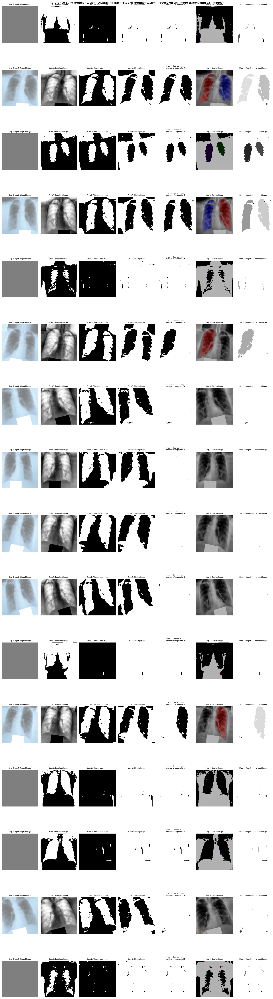

In [407]:
IST.display_how_segmentize_work_steps(images=X_over_sampling_eq,
                                      target=y_over_sampling,
                                      num_display=16, 
                                      title='Reference Lung Segmentation: Displaying Each Step of Segmentation Process on an Image',
                                      cmap='binary',
                                      random_mode= True)

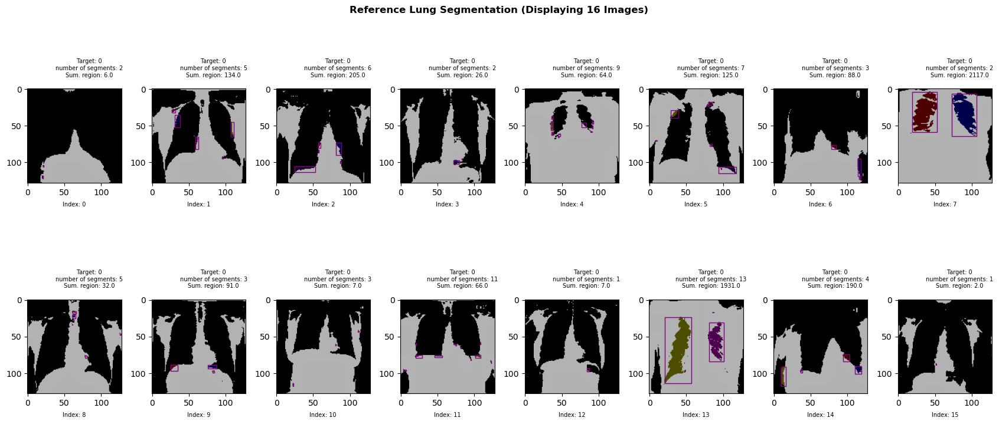

In [408]:
IST.display(images=X_over_sampling_eq,
                       target=y_over_sampling,
                       num_display=16, 
                       num_cols=8,
                       title='Reference Lung Segmentation',
                       cmap='binary',
                       random_mode=False,
                       only_segmented=False)

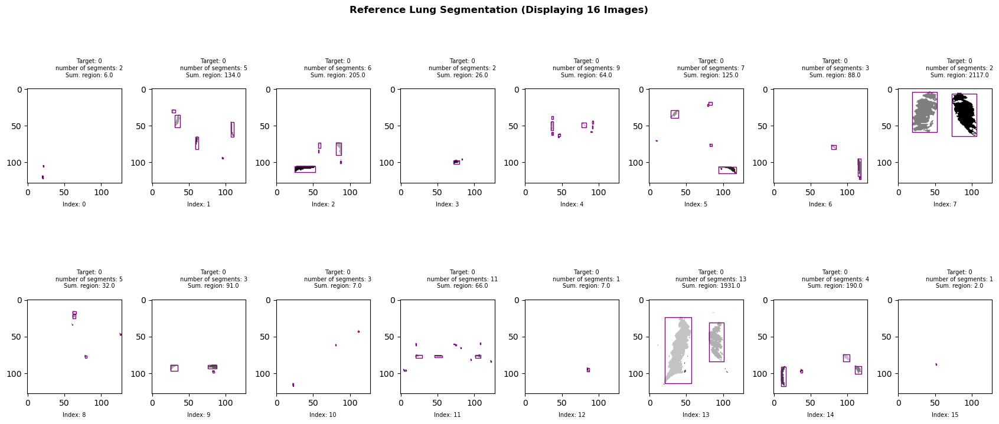

In [409]:
IST.display(images=X_over_sampling_eq,
             target=y_over_sampling,
             num_display=16, num_cols=8,
             title='Reference Lung Segmentation',
             cmap='binary',
             random_mode=False,
             only_segmented=True)

In [410]:
!pip install lime

In [411]:
# Lime
import lime
from lime.lime_image import LimeImageExplainer
# Ski
from skimage.segmentation import mark_boundaries
from skimage.color import gray2rgb
from skimage.transform import resize

import skimage.segmentation

# common
import numpy as np
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
import random

import cv2
import matplotlib.patches as mpatches
from skimage.filters import threshold_otsu
from skimage.exposure import equalize_adapthist
from skimage.color import label2rgb
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import square, closing
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.filters import sobel
from skimage.color import rgb2gray

In [412]:
class Explainer:
    def __init__(self, estimator, input_shape=None):
        """
        Initialize the Explainer object.

        Parameters:
            estimator (object): The machine learning model to be explained.
            input_shape (tuple, optional): The shape of the input images. Default is None.
        """
        self.estimator = estimator
        self.input_shape = input_shape
        self.explainer = LimeImageExplainer()
        self.IST = ImageSegmentation(input_shape=input_shape, 
                        clip_limit=0.015, 
                        sqr_value=1)
        
        
        self.methods = [
            (felzenszwalb, {'scale': 200, 'sigma': 0.5, 'min_size': 50}, "felzenszwalb"),
            (slic, {'n_segments': 50, 'compactness': 10, 'sigma': 1}, 'slic'),
            (quickshift, {'kernel_size': 2, 'max_dist': 50, 'ratio': 0.5}, 'quickshift'),
            (watershed, {'markers': 50, 'compactness': 0.001}, 'watershed'),
            (self.ref_lung_segmentation, {}, 'reference_lung_segmentation')
        ]
        
    def transform(self, image):
        """
        Resize the input image to the specified input shape.

        Parameters:
            image (ndarray): The input image to be resized.

        Returns:
            ndarray: The resized image.
        """
        image_resized = tf.image.resize(image, self.input_shape).numpy()
        return image_resized
    
    def segment_fn(self, seg_method):
        """
        Get the segmentation function based on the segmentation method.

        Parameters:
            seg_method (str): The segmentation method.

        Returns:
            function: The segmentation function corresponding to the method.
        
        Raises:
            ValueError: If the segmentation method is invalid.
        """
        if seg_method == 'felzenszwalb':
            return felzenszwalb
        elif seg_method == 'slic':
            return slic
        elif seg_method == 'quickshift':
            return quickshift
        elif seg_method == 'watershed':
            return watershed
        elif seg_method == 'reference_lung_segmentation':
            return self.ref_lung_segmentation
        else:
            raise ValueError(
                "Invalid segmentation method. Supported methods: 'felzenszwalb', 'slic', 'quickshift', 'watershed', 'reference_lung_segmentation'")
    
    def lime(self, image, a_y_pred, seg_method, top_labels, num_samples, num_features):
        """
        Generate Lime explanations for the input image.

        Parameters:
            image (ndarray): The input image.
            a_y_pred (int): The predicted label for the image.
            seg_method (str): The segmentation method.
            top_labels (int): The top labels to consider.
            num_samples (int): Number of samples for Lime.
            num_features (int): Number of features for Lime explanations.

        Returns:
            tuple: Tuple containing the Lime explanation image and mask.
        """
        explanation = self.explainer.explain_instance(
                image,
                self.estimator.predict,
                top_labels=top_labels,
                hide_color=0,
                num_samples=num_samples,
                segmentation_fn=self.segment_fn(seg_method),
            )
        
        pos_condition = True if a_y_pred == 1 else False
        
        # condition variable: If model's prediction is Disease or 1, then display/reveal positive region on image
        temp, mask = explanation.get_image_and_mask(
            0,
            positive_only=pos_condition,
            num_features=num_features,
            hide_rest=False,
            min_weight=0.0,
            )
        return temp, mask
    
    def display_explanation_plot(self, X, y, y_pred, y_prob , seg_method, top_labels, num_samples, num_features, class_names, num_display, random_mode):
        """
        Display the explanation plot for model predictions using Lime.

        Parameters:
            X (ndarray): Input data as a numpy array.
            y (ndarray): Target data as a numpy array.
            y_pred (ndarray): Predicted labels for the input data.
            y_prob (ndarray): Predicted probabilities for the input data.
            seg_method (str): The segmentation method.
            top_labels (int): The top labels to consider.
            num_samples (int): Number of samples for Lime.
            num_features (int): Number of features for Lime explanations.
            class_names (list): List of class names.
            num_display (int): Number of images to display.
            random_mode (bool): If True, display images randomly.
        """
        prefix_bold = r'$\bf{'
        suffix_bold = '}$'
        """
            Number of rows/columns of the subplot grid.
        """
        n_cols = 4  # Display 4 images in each row
        n_rows = min(num_display, len(X))

        # Choose random indices if random_mode is True
        if random_mode:
            random_indices = np.random.choice(
                len(X), n_rows, replace=False)
        else:
            random_indices = np.arange(n_rows)
            
        # Create the subplot grid
        fig, axes = plt.subplots(
            nrows=n_rows, ncols=n_cols, figsize=(15, n_cols*n_rows))
        fig.subplots_adjust(hspace=0.4)  # Adjust vertical space between rows
        for i, ax in enumerate(axes.flatten()):
            if i >= n_rows:  # Check if the index exceeds the available number of images
                break
            # Get the index of the current image
            index = random_indices[i]
            
            """
                Transform
            """
            X_resized = self.transform(X[index])
            """
                Acutal & Prediction
                - apply int():  to make sure it's integer when checking condition, For example:
                    - 1 == 1 is True
                    - 1.0 == 1 is False
            """
        
            single_y_actual = int(y[index])
            single_y_pred = int(y_pred[index])
            single_y_prob = y_prob[index]
            
            temp, mask = self.lime(X_resized, single_y_pred, seg_method, top_labels, num_samples, num_features)
            """
                Plot Title 
            """
            
            # Title A
            A_actual_class = class_names.get(single_y_actual)  
            A_actual_title = prefix_bold + 'Actual' + suffix_bold + '\nTarget: ' + f"{single_y_actual} ({A_actual_class})"
            # Title B
            B_model_class = class_names.get(single_y_pred)  
            B_model_prob = '{:.5f}'.format(float(single_y_prob))
            B_model_title = prefix_bold + 'Model-Prediction' + suffix_bold + f'\nProbability: ' + B_model_prob + '\nTarget: ' + f"{single_y_pred} ({B_model_class})"
            
            
            # Find the segmentation method kwargs
            kwarg = None
            for (method, kwargs, title) in self.methods:
                if title == seg_method:
                    kwarg = kwargs
                    break  

            if kwarg is None:
                kwargs = {}  
                    
            # Title C
            segmentation_method = self.segment_fn(seg_method)
            segmentized_image = segmentation_method(X_resized, **kwarg)
            
            num_segments = len(np.unique(segmentized_image))
            C_segmentaion_title = prefix_bold + 'Segmentation' + suffix_bold  + f'\nmethod:{seg_method}\nnumber of segments: {num_segments}'
            # Title D
            D_lime_title = prefix_bold + 'LIME-Explanation' + suffix_bold + f'\ndisplay: {num_features} features' + f'\nPositive and Negative regions'

            # Actual 
            """
                Show
            """
            axes[i,0].imshow(X_resized, cmap=cmap) 
            axes[i,0].set_title(A_actual_title)
            
            image_label_overlay = label2rgb(
                segmentation_method(X_resized, **kwarg),
                image=X_resized,
                bg_label=0,
                bg_color=(0, 0, 0))
            
            # Model prediction 
            axes[i,1].imshow(X_resized, cmap=cmap)
            axes[i,1].imshow(image_label_overlay)

            axes[i,1].set_title(B_model_title)
            # Segmentation

            axes[i,2].imshow(segmentized_image,cmap='binary')
            axes[i,2].set_title(C_segmentaion_title)
            # Lime
            boundaried_image = mark_boundaries(temp/2 + 0.5, mask)
            
            axes[i,3].imshow(boundaried_image)
            axes[i,3].set_title(D_lime_title)
            
            # Add the image index text
            image_info = f'Image Index: {index}'
            x_axis = 0.5
            y_axis = -0.15
            plt.text(x_axis, y_axis, image_info, transform=axes[i,0].transAxes,
                     fontsize=10, ha='center')
        
        title = prefix_bold + "Model-Explainability" + suffix_bold + f"\n{prefix_bold}Library{suffix_bold}: Lime"+ f"\n{prefix_bold}Segmentation{suffix_bold}: {seg_method}"
        plt.suptitle(title, fontsize=14)
        plt.tight_layout()
        plt.show()
        

    def explain(self, X, y, top_labels, num_samples, num_features, class_names, num_display, seg_method='slic', random_mode=False, cmap='gray'):
        '''
        Explain and visualize model predictions using LIME (Local Interpretable Model-Agnostic Explanations).

        Parameters:
            X (ndarray): Input data as a numpy array.
            y (ndarray): Target data as a numpy array.
            top_labels (int): Top coefficients to show (e.g., 1 for binary classification).
            num_samples (int): Number of perturbations to generate.
            num_features (int): Number of highlighted features (segmented areas) to extract.
            class_names (dict): List of class names contains key and value. (For examples, {"Normal": 0, "Tuberculosis":1})
            num_display (int): Number of images to display.
            seg_method (str, optional): The segmentation method to use. Default is 'slic'.
            random_mode (bool, optional): If True, display images randomly. Default is False.
            cmap (str, optional): Colormap for displaying images. Default is 'gray'.

        Returns:
            None

        This function explains and visualizes model predictions using LIME. It generates explanations for model predictions and displays them along with various image representations.

        Note:
        - The `X` input should have a shape like (num_images, width, height, channels) (e.g., (100, 128, 128, 1)).
        - The `class_names` list should contain class labels.
        - The function displays the explanations and does not return any values.
        '''

        # Model prediction
        y_pred, y_prob = self.estimator.predict_(X)
        self.display_explanation_plot(X, y, y_pred, y_prob, seg_method, top_labels, num_samples, num_features,class_names, num_display, random_mode)
        
    def diff_segmentation(self, image):
        """
        Display the effect of different segmentation methods on an image.

        Parameters:
            image (ndarray): The input image.
        """
        sample_index = random.randint(0, image.shape[0] - 1)
        image = image[sample_index]
        fig, ax = plt.subplots(1, 5, figsize=(17, 6))

        for i, (method, kwargs, title) in enumerate(self.methods):
            if method == watershed:
                gradient = sobel(rgb2gray(image))
                segments = method(gradient, **kwargs)  # Pass gradient to watershed
            elif method == self.ref_lung_segmentation:
                segments = method(image)  # Just pass image to your custom segmentation
            else:
                segments = method(image, **kwargs)  # For other methods, pass image directly
            ax[i].imshow(mark_boundaries(image, segments))
            ax[i].set_title(title)
            ax[i].text(
                0.5, -0.05, f"number of segments: {len(np.unique(segments))}", transform=ax[i].transAxes, ha='center')
            ax[i].set_axis_off()

        plt.tight_layout()
        plt.show()

    def ref_lung_segmentation(self, image, return_overlay=False):
        """
        Perform lung segmentation on the input image.

        Parameters:
            image (ndarray): The input image.
            return_overlay (bool, optional): Whether to return the segmentation overlay image. Default is False.

        Returns:
            ndarray: The lung segmentation mask.
        """
        image_label_overlay, label_image = IST.segmentize(
                image)
        if return_overlay:
            return image_label_overlay, label_image
        else:
            return label_image

In [413]:
explnr = Explainer(estimator=cnn_ba, input_shape=(128, 128))

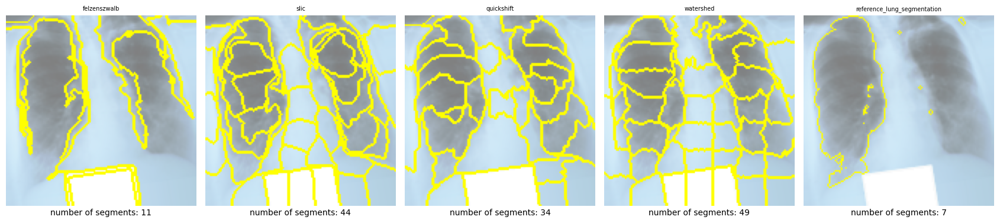

In [414]:
explnr.diff_segmentation(image=X_test)

In [415]:
"""
    top_labels:  top_labels set to 1, Lime consider the top class predicted by the model, In this case binary classification tasks where you are interested in explaining the model's prediction for the positive class.
"""
top_labels = 1

num_samples = 100
num_features = 5
"""
    class_names: Class label, 
        0 assigned as Normal class, 
        1 assigned as Tuberculosis class
"""
class_names = {0: "Normal", 1:"Tuberculosis"}
num_display = 20

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:229: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


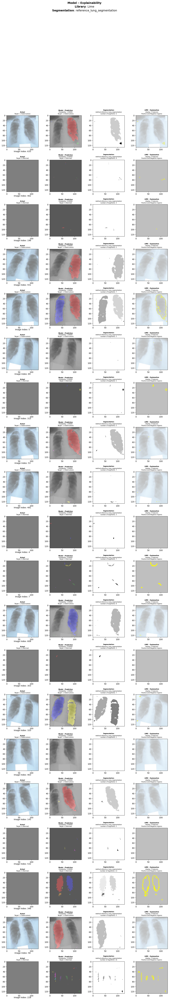

In [416]:
explnr.explain(X=X_test,
            y=y_test,
            top_labels=top_labels,
            num_samples=num_samples,
            num_features=num_features,
            class_names=class_names,
            num_display=num_display,
            seg_method='reference_lung_segmentation',
            random_mode=True,
            cmap='gray'
            )

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:229: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


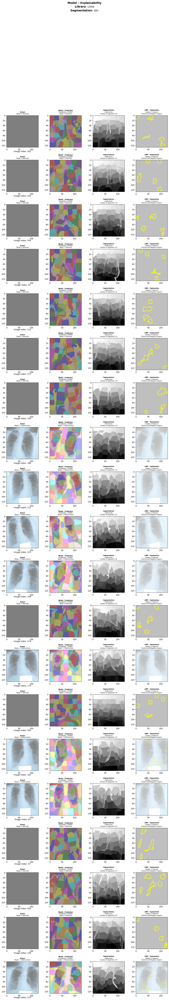

In [417]:
explnr.explain(X=X_test,
            y=y_test,
            top_labels=top_labels,
            num_samples=num_samples,
            num_features=num_features,
            class_names=class_names,
            num_display=num_display,
            seg_method='slic',
            random_mode=True,
            cmap='gray'
            )


22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  single_y_pred = int(y_pred[index])


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  B_model_prob = '{:.5f}'.format(float(single_y_prob))
/var/folders/8g/67_bv1sj0qd8dqx1hn0tg5pr0000gn/T/ipykernel_1393/307380149.py:229: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


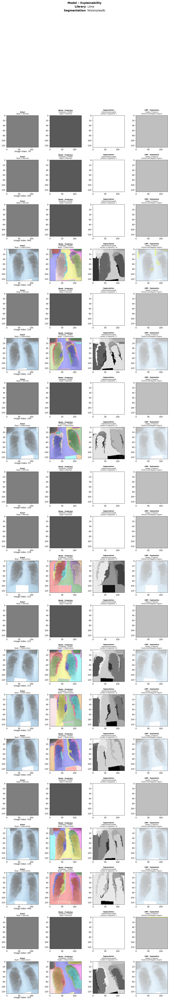

In [418]:
explnr.explain(X=X_test,
            y=y_test,
            top_labels=top_labels,
            num_samples=num_samples,
            num_features=num_features,
            class_names=class_names,
            num_display=num_display,
            seg_method='felzenszwalb',
            random_mode=True,
            cmap='gray'
            )
